# Import Libraries

In [1]:
import joblib
import time
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from math import radians
import plotly.express as px

from sklearn.metrics.pairwise import haversine_distances
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split, RandomizedSearchCV
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix

from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import GradientBoostingRegressor

from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier

import warnings
warnings.filterwarnings("ignore")

### Set the style for visualizations

In [2]:
plt.style.use('seaborn-v0_8-whitegrid')
sns.set_palette("deep")
plt.rcParams['figure.figsize'] = (12, 8)
plt.rcParams['font.size'] = 12

# Load the data

In [224]:
from google.colab import drive
drive.mount('/content/drive')

ModuleNotFoundError: No module named 'google.colab'

In [3]:
uber = pd.read_csv('../data/uber.csv')

In [4]:
uber.T

,0,1,2,3,4,5,6,7,8,9,...,199990,199991,199992,199993,199994,199995,199996,199997,199998,199999
Unnamed: 0,24238194,27835199,44984355,25894730,17610152,44470845,48725865,44195482,15822268,50611056,...,9577367,13512837,20566507,28359558,3189201,42598914,16382965,27804658,20259894,11951496
key,2015-05-07 19:52:06.0000003,2009-07-17 20:04:56.0000002,2009-08-24 21:45:00.00000061,2009-06-26 08:22:21.0000001,2014-08-28 17:47:00.000000188,2011-02-12 02:27:09.0000006,2014-10-12 07:04:00.0000002,2012-12-11 13:52:00.00000029,2012-02-17 09:32:00.00000043,2012-03-29 19:06:00.000000273,...,2015-05-24 22:05:56.0000002,2015-06-08 10:49:14.0000001,2010-01-30 16:24:00.000000199,2012-09-29 19:51:27.0000006,2014-01-31 14:42:00.000000181,2012-10-28 10:49:00.00000053,2014-03-14 01:09:00.0000008,2009-06-29 00:42:00.00000078,2015-05-20 14:56:25.0000004,2010-05-15 04:08:00.00000076
fare_amount,7.5,7.7,12.9,5.3,16.0,4.9,24.5,2.5,9.7,12.5,...,12.0,17.5,8.9,9.5,12.0,3.0,7.5,30.9,14.5,14.1
pickup_datetime,2015-05-07 19:52:06 UTC,2009-07-17 20:04:56 UTC,2009-08-24 21:45:00 UTC,2009-06-26 08:22:21 UTC,2014-08-28 17:47:00 UTC,2011-02-12 02:27:09 UTC,2014-10-12 07:04:00 UTC,2012-12-11 13:52:00 UTC,2012-02-17 09:32:00 UTC,2012-03-29 19:06:00 UTC,...,2015-05-24 22:05:56 UTC,2015-06-08 10:49:14 UTC,2010-01-30 16:24:00 UTC,2012-09-29 19:51:27 UTC,2014-01-31 14:42:00 UTC,2012-10-28 10:49:00 UTC,2014-03-14 01:09:00 UTC,2009-06-29 00:42:00 UTC,2015-05-20 14:56:25 UTC,2010-05-15 04:08:00 UTC
pickup_longitude,-73.999817,-73.994355,-74.005043,-73.976124,-73.925023,-73.969019,-73.961447,0.0,-73.975187,-74.001065,...,-73.987106,-73.981453,-74.003548,-73.987798,-73.98307,-73.987042,-73.984722,-73.986017,-73.997124,-73.984395
pickup_latitude,40.738354,40.728225,40.74077,40.790844,40.744085,40.75591,40.693965,0.0,40.745767,40.741787,...,40.741894,40.743919,40.714045,40.72121,40.76077,40.739367,40.736837,40.756487,40.725452,40.720077
dropoff_longitude,-73.999512,-73.99471,-73.962565,-73.965316,-73.973082,-73.969019,-73.871195,0.0,-74.00272,-73.96304,...,-73.95224,-74.013908,-73.991053,-73.98096,-73.972972,-73.986525,-74.006672,-73.858957,-73.983215,-73.985508
dropoff_latitude,40.723217,40.750325,40.772647,40.803349,40.761247,40.75591,40.774297,0.0,40.743537,40.775012,...,40.772957,40.712635,40.6845,40.744388,40.754177,40.740297,40.73962,40.692588,40.695415,40.768793
passenger_count,1,1,1,3,5,1,5,1,1,1,...,1,1,1,1,1,1,1,2,1,1


## Display basic information

In [5]:
print("\nBasic information about the dataset:")
print(f"Shape of the dataset: {uber.shape}")
print("\nFirst 5 rows of the dataset:")
uber.head()


Basic information about the dataset:
Shape of the dataset: (200000, 9)

First 5 rows of the dataset:


,Unnamed: 0,key,fare_amount,pickup_datetime,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count
0,24238194,2015-05-07 19:52:06.0000003,7.5,2015-05-07 19:52:06 UTC,-73.999817,40.738354,-73.999512,40.723217,1
1,27835199,2009-07-17 20:04:56.0000002,7.7,2009-07-17 20:04:56 UTC,-73.994355,40.728225,-73.994710,40.750325,1
2,44984355,2009-08-24 21:45:00.00000061,12.9,2009-08-24 21:45:00 UTC,-74.005043,40.740770,-73.962565,40.772647,1
3,25894730,2009-06-26 08:22:21.0000001,5.3,2009-06-26 08:22:21 UTC,-73.976124,40.790844,-73.965316,40.803349,3
4,17610152,2014-08-28 17:47:00.000000188,16.0,2014-08-28 17:47:00 UTC,-73.925023,40.744085,-73.973082,40.761247,5


In [6]:
print("\nData types and non-null counts:")
uber.info()


Data types and non-null counts:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 200000 entries, 0 to 199999
Data columns (total 9 columns):
 #   Column             Non-Null Count   Dtype  
---  ------             --------------   -----  
 0   Unnamed: 0         200000 non-null  int64  
 1   key                200000 non-null  object 
 2   fare_amount        200000 non-null  float64
 3   pickup_datetime    200000 non-null  object 
 4   pickup_longitude   200000 non-null  float64
 5   pickup_latitude    200000 non-null  float64
 6   dropoff_longitude  199999 non-null  float64
 7   dropoff_latitude   199999 non-null  float64
 8   passenger_count    200000 non-null  int64  
dtypes: float64(5), int64(2), object(2)
memory usage: 13.7+ MB


In [7]:
print("\nSummary statistics:")
uber.describe()


Summary statistics:


,Unnamed: 0,fare_amount,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count
count,2.000000e+05,200000.000000,200000.000000,200000.000000,199999.000000,199999.000000,200000.000000
mean,2.771250e+07,11.359955,-72.527638,39.935885,-72.525292,39.923890,1.684535
std,1.601382e+07,9.901776,11.437787,7.720539,13.117408,6.794829,1.385997
min,1.000000e+00,-52.000000,-1340.648410,-74.015515,-3356.666300,-881.985513,0.000000
25%,1.382535e+07,6.000000,-73.992065,40.734796,-73.991407,40.733823,1.000000
50%,2.774550e+07,8.500000,-73.981823,40.752592,-73.980093,40.753042,1.000000
75%,4.155530e+07,12.500000,-73.967154,40.767158,-73.963658,40.768001,2.000000
max,5.542357e+07,499.000000,57.418457,1644.421482,1153.572603,872.697628,208.000000


In [8]:
print("\nMissing values count:")
uber.isnull().sum()


Missing values count:


Unnamed: 0           0
key                  0
fare_amount          0
pickup_datetime      0
pickup_longitude     0
pickup_latitude      0
dropoff_longitude    1
dropoff_latitude     1
passenger_count      0
dtype: int64

# Data Analysis

In [9]:
# 1. Convert pickup_datetime to datetime format..
uber['pickup_datetime'] = pd.to_datetime(uber['pickup_datetime'])


In [10]:
# 2. Extract date-time features
uber['pickup_hour'] = uber['pickup_datetime'].dt.hour
uber['pickup_day'] = uber['pickup_datetime'].dt.day
uber['pickup_month'] = uber['pickup_datetime'].dt.month
uber['pickup_year'] = uber['pickup_datetime'].dt.year
uber['pickup_weekday'] = uber['pickup_datetime'].dt.dayofweek # 0 is Monday, 6 is Sunday
uber['pickup_is_weekend'] = uber['pickup_weekday'].apply(lambda x: 1 if x >= 5 else 0) # 1 if weekend, 0 otherwise

In [11]:
df = pd.read_csv("..\\data\\uber.csv")

# long_min, long_max = -74.7, -73.7
# lat_min, lat_max = 40.5, 40.9

# Count before filtering
before_count = len(df)

# # Apply filters
# df = df[
#     (df['pickup_longitude'] >= long_min) & (df['pickup_longitude'] <= long_max) &
#     (df['pickup_latitude'] >= lat_min) & (df['pickup_latitude'] <= lat_max) &
#     (df['dropoff_longitude'] >= long_min) & (df['dropoff_longitude'] <= long_max) &
#     (df['dropoff_latitude'] >= lat_min) & (df['dropoff_latitude'] <= lat_max)
# ]


# Create a scatter map using Plotly Express
fig = px.scatter_mapbox(
    df,
    lat='pickup_latitude',          # Column name for latitude
    lon='pickup_longitude',          # Column name for longitude
    zoom=2,             # Adjust zoom level
    height=600
)

# Set the map style (options: 'open-street-map', 'carto-positron', etc.)
fig.update_layout(mapbox_style='open-street-map')

# Center the map based on mean coordinates
fig.update_layout(
    mapbox_center={'lat': df['pickup_latitude'].mean(), 'lon': df['pickup_longitude'].mean()}
)

# Show the map
fig.show()

## Define geographical boundaries for different cities/countries

In [12]:
# Define coordinate boundaries for different locations
location_boundaries = {
    'New York City, USA': {
        'long_min': -74.7, 'long_max': -73.7,
        'lat_min': 40.5, 'lat_max': 40.9
    }
}

In [13]:
# Function to identify location based on coordinates
def identify_location(lon, lat):
    for location, bounds in location_boundaries.items():
        if (bounds['long_min'] <= lon <= bounds['long_max'] and
            bounds['lat_min'] <= lat <= bounds['lat_max']):
            return location
    return "UNKNOWN"

In [14]:
# Add pickup and dropoff location columns
uber['pickup_location'] = uber.apply(lambda row: identify_location(
    row['pickup_longitude'], row['pickup_latitude']), axis=1)
uber['dropoff_location'] = uber.apply(lambda row: identify_location(
    row['dropoff_longitude'], row['dropoff_latitude']), axis=1)

# Create a column that identifies if pickup and dropoff are in the same location
uber['same_location'] = (uber['pickup_location'] == uber['dropoff_location'])

In [15]:
# Print location distribution
print("\nDistribution of pickup locations:")
uber['pickup_location'].value_counts()


Distribution of pickup locations:


pickup_location
New York City, USA    195846
UNKNOWN                 4154
Name: count, dtype: int64

In [16]:
print("\nDistribution of dropoff locations:")
uber['dropoff_location'].value_counts()


Distribution of dropoff locations:


dropoff_location
New York City, USA    195759
UNKNOWN                 4241
Name: count, dtype: int64

In [17]:
# 4. Remove outliers in fare amounts and distances (but keep all locations)
print("\nRemoving fare amount and distance outliers...")
before_count = len(df)

# Filter fare amounts (between $2.50 and $100)
# there are about 40 negative samples and sixty samples with values greater than 100
uber = uber[(uber['fare_amount'] >= 2.5) & (uber['fare_amount'] <= 100)]

# Filter passenger count (between 1 and 6)
# 709 rows with passenger_count = 0
uber = uber[(uber['passenger_count'] >= 1) & (uber['passenger_count'] <= 6)]

after_count = len(uber)
print(f"Removed {before_count - after_count} rows with unreasonable fare amounts or passenger counts ({(before_count - after_count) / before_count * 100:.2f}%)")



Removing fare amount and distance outliers...
Removed 819 rows with unreasonable fare amounts or passenger counts (0.41%)


In [18]:
# 5. Calculate trip distance using Haversine formula
def calculate_distance(lat1, long1, lat2, long2):
    """
    Calculate the distance between two points using the Haversine formula
    """
    # Convert to radians
    lat1, long1, lat2, long2 = map(radians, [lat1, long1, lat2, long2])

    # Put coordinates into the format required by haversine_distances
    coord1 = np.array([[lat1, long1]])
    coord2 = np.array([[lat2, long2]])

    # Calculate distance in km
    distance_km = haversine_distances(coord1, coord2)[0][0] * 6371  # Earth's radius in km

    return distance_km

# Apply the distance calculation to the dataset
uber['trip_distance'] = uber.apply(lambda row: calculate_distance(
    row['pickup_latitude'], row['pickup_longitude'],
    row['dropoff_latitude'], row['dropoff_longitude']
), axis=1)

In [19]:
# Filter trip distances (less than 100 km and greater than 0.5)
uber = uber[(uber['trip_distance'] > 0.5) & (uber['trip_distance'] <= 100)]

In [20]:
# 6. Calculate derived features
# Calculate fare per km
uber['fare_per_km'] = uber['fare_amount'] / uber['trip_distance']

# Calculate fare per passenger
uber['fare_per_passenger'] = uber['fare_amount'] / uber['passenger_count']

In [21]:
# 7. Create time period categories
def categorize_time(hour):
    if 5 <= hour < 12:
        return 'Morning'
    elif 12 <= hour < 17:
        return 'Afternoon'
    elif 17 <= hour < 22:
        return 'Evening'
    else:
        return 'Night'

uber['time_period'] = uber['pickup_hour'].apply(categorize_time)

## Summary statistics after some cleaning

In [22]:
print("\nSummary statistics after cleaning:")
uber.describe()


Summary statistics after cleaning:


,Unnamed: 0,fare_amount,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count,pickup_hour,pickup_day,pickup_month,pickup_year,pickup_weekday,pickup_is_weekend,trip_distance,fare_per_km,fare_per_passenger
count,1.871640e+05,187164.000000,187164.000000,187164.000000,187164.000000,187164.000000,187164.000000,187164.000000,187164.000000,187164.000000,187164.000000,187164.000000,187164.000000,187164.000000,187164.000000,187164.000000
mean,2.770189e+07,11.443424,-73.917922,40.696459,-73.916906,40.694821,1.689876,13.498520,15.704153,6.283911,2011.751389,3.050784,0.283863,3.454309,4.180279,9.168694
std,1.600991e+07,9.310196,2.547689,2.649540,2.547785,2.515540,1.305065,6.520678,8.685877,3.438578,1.861720,1.946829,0.450873,3.718655,2.106689,8.595994
min,1.000000e+00,2.500000,-75.387785,-74.015515,-75.417737,-74.015750,1.000000,0.000000,1.000000,1.000000,2009.000000,0.000000,0.000000,0.500052,0.053448,0.500000
25%,1.381585e+07,6.100000,-73.992308,40.736440,-73.991610,40.735260,1.000000,9.000000,8.000000,3.000000,2010.000000,1.000000,0.000000,1.351248,2.944642,4.500000
50%,2.772254e+07,8.500000,-73.982185,40.753208,-73.980593,40.753682,1.000000,14.000000,16.000000,6.000000,2012.000000,3.000000,0.000000,2.250306,3.766649,6.900000
75%,4.153456e+07,12.900000,-73.968623,40.767490,-73.965637,40.768314,2.000000,19.000000,23.000000,9.000000,2013.000000,5.000000,1.000000,4.030230,4.896805,10.900000
max,5.542357e+07,100.000000,40.806012,401.066667,40.831932,42.464187,6.000000,23.000000,31.000000,12.000000,2015.000000,6.000000,1.000000,99.162509,124.697187,100.000000


In [23]:
print("\nMissing values after cleaning:")
uber.isnull().sum()


Missing values after cleaning:


Unnamed: 0            0
key                   0
fare_amount           0
pickup_datetime       0
pickup_longitude      0
pickup_latitude       0
dropoff_longitude     0
dropoff_latitude      0
passenger_count       0
pickup_hour           0
pickup_day            0
pickup_month          0
pickup_year           0
pickup_weekday        0
pickup_is_weekend     0
pickup_location       0
dropoff_location      0
same_location         0
trip_distance         0
fare_per_km           0
fare_per_passenger    0
time_period           0
dtype: int64

In [24]:
print("\nUnique pickup locations after cleaning:")
pickup_locations = uber['pickup_location'].value_counts()
pickup_locations


Unique pickup locations after cleaning:


pickup_location
New York City, USA    186985
UNKNOWN                  179
Name: count, dtype: int64

In [25]:
df = uber.copy()[uber['dropoff_location'] == 'New York City, USA']

long_min, long_max = -74.7, -73.7
lat_min, lat_max = 40.5, 40.9

# Count before filtering
before_count = len(df)


# Create a scatter map using Plotly Express
fig = px.scatter_mapbox(
    df,
    lat='pickup_latitude',          # Column name for latitude
    lon='pickup_longitude',          # Column name for longitude
    zoom=2,             # Adjust zoom level
    height=600
)

# Set the map style (options: 'open-street-map', 'carto-positron', etc.)
fig.update_layout(mapbox_style='open-street-map')

# Center the map based on mean coordinates
fig.update_layout(
    mapbox_center={'lat': df['pickup_latitude'].mean(), 'lon': df['pickup_longitude'].mean()}
)

# Show the map
fig.show()

# Exploratory Data Analysis (EDA)

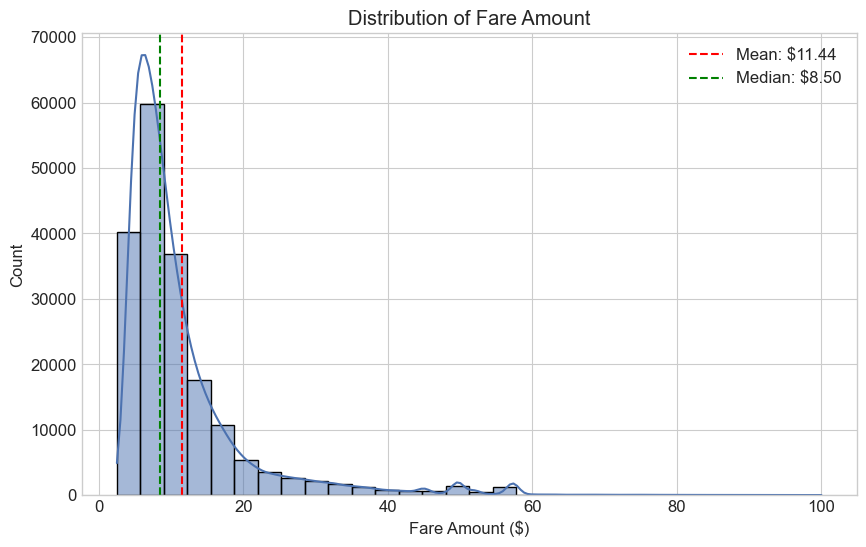

In [26]:
# 1. Distribution of fare amount
plt.figure(figsize=(10, 6))
sns.histplot(uber['fare_amount'], bins=30, kde=True)
plt.title('Distribution of Fare Amount')
plt.xlabel('Fare Amount ($)')
plt.ylabel('Count')
plt.axvline(uber['fare_amount'].mean(), color='red', linestyle='--', label=f'Mean: ${uber["fare_amount"].mean():.2f}')
plt.axvline(uber['fare_amount'].median(), color='green', linestyle='--', label=f'Median: ${uber["fare_amount"].median():.2f}')
plt.legend()
plt.show()

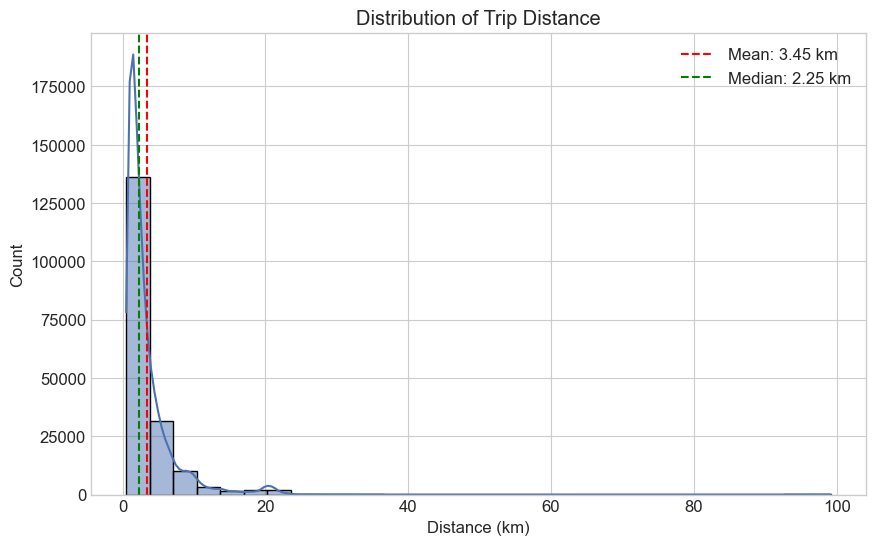

In [27]:
# 2. Distribution of trip distance
plt.figure(figsize=(10, 6))
sns.histplot(uber['trip_distance'], bins=30, kde=True)
plt.title('Distribution of Trip Distance')
plt.xlabel('Distance (km)')
plt.ylabel('Count')
plt.axvline(uber['trip_distance'].mean(), color='red', linestyle='--', label=f'Mean: {uber["trip_distance"].mean():.2f} km')
plt.axvline(uber['trip_distance'].median(), color='green', linestyle='--', label=f'Median: {uber["trip_distance"].median():.2f} km')
plt.legend()
plt.show()


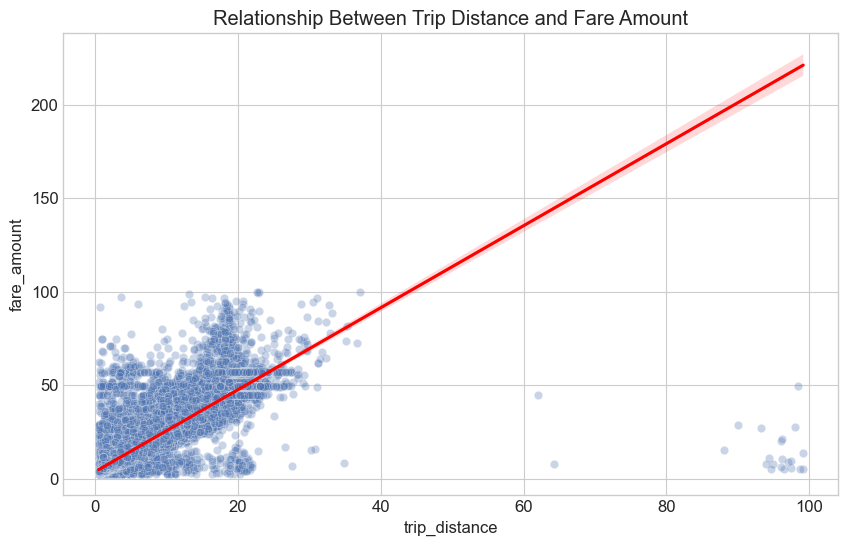

In [28]:
# 3. Relationship between distance and fare
plt.figure(figsize=(10, 6))
sns.scatterplot(x='trip_distance', y='fare_amount', data=uber, alpha=0.3)
plt.title('Relationship Between Trip Distance and Fare Amount')
plt.xlabel('Trip Distance (km)')
plt.ylabel('Fare Amount ($)')

# Add a trend line
sns.regplot(x='trip_distance', y='fare_amount', data=uber, scatter=False, color='red')
plt.show()

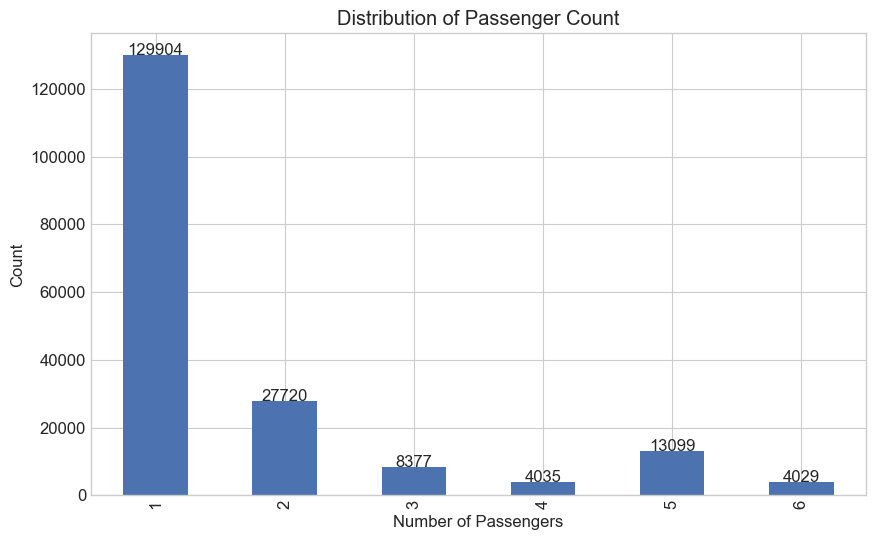

In [29]:
# 4. Distribution of passenger count
plt.figure(figsize=(10, 6))
passenger_counts = uber['passenger_count'].value_counts().sort_index()
ax = passenger_counts.plot(kind='bar')
plt.title('Distribution of Passenger Count')
plt.xlabel('Number of Passengers')
plt.ylabel('Count')

# Add value labels on top of bars
for i, v in enumerate(passenger_counts):
    ax.text(i, v + 0.1, str(v), ha='center')

plt.show()

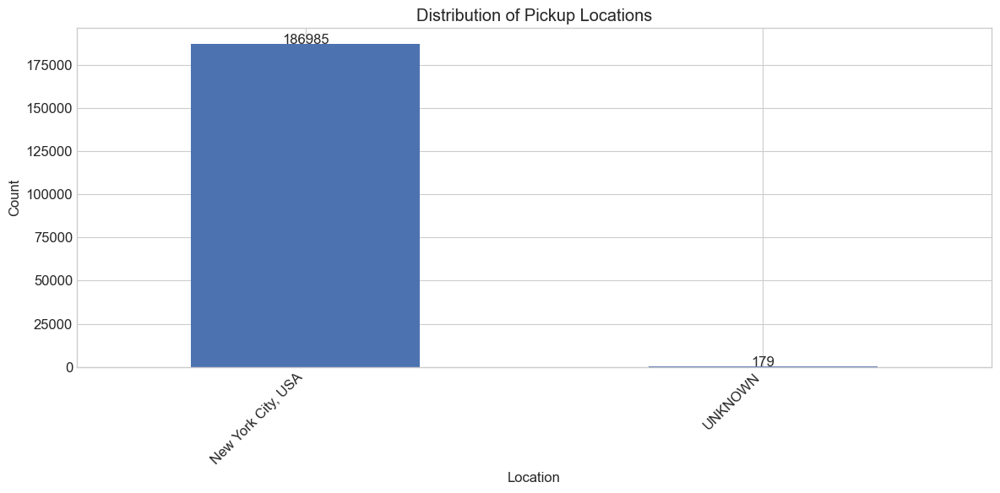

In [30]:
# 5. Distribution of pickup locations
plt.figure(figsize=(12, 6))
pickup_loc_counts = uber['pickup_location'].value_counts()
ax = pickup_loc_counts.plot(kind='bar')
plt.title('Distribution of Pickup Locations')
plt.xlabel('Location')
plt.ylabel('Count')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()

# Add value labels on top of bars
for i, v in enumerate(pickup_loc_counts):
    ax.text(i, v + 0.1, str(v), ha='center')

plt.show()

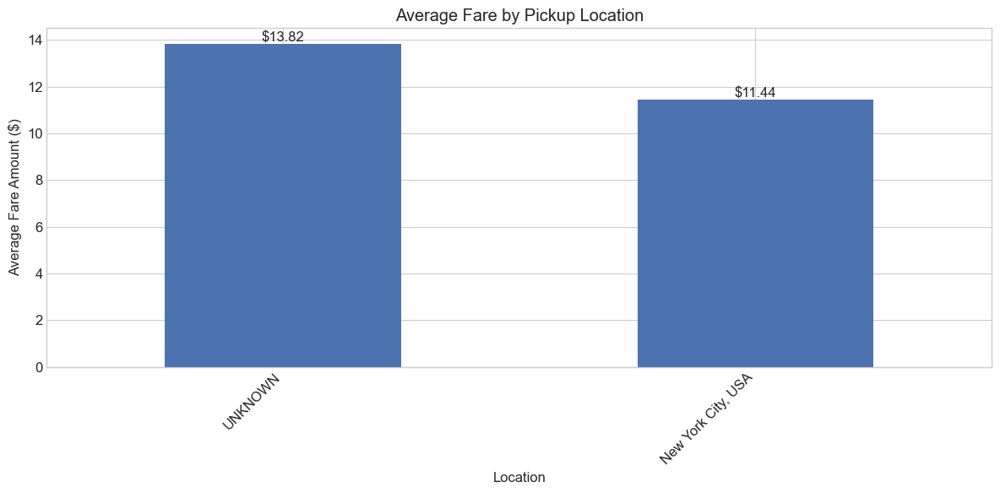

In [31]:
# 6. Average fare by location
plt.figure(figsize=(12, 6))
fare_by_location = uber.groupby('pickup_location')['fare_amount'].mean().sort_values(ascending=False)
ax = fare_by_location.plot(kind='bar')
plt.title('Average Fare by Pickup Location')
plt.xlabel('Location')
plt.ylabel('Average Fare Amount ($)')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()

# Add value labels on top of bars
for i, v in enumerate(fare_by_location):
    ax.text(i, v + 0.1, f'${v:.2f}', ha='center')

plt.show()

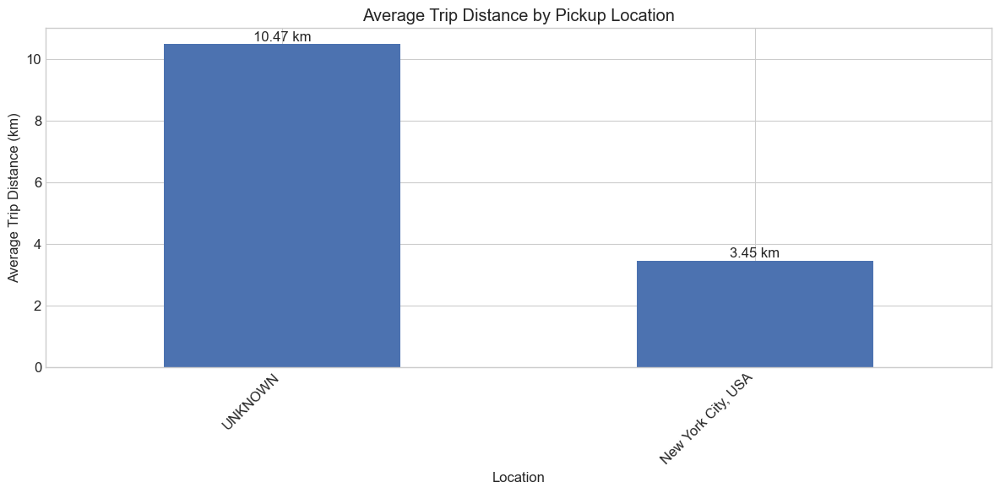

In [32]:
# 7. Average distance by location
plt.figure(figsize=(12, 6))
distance_by_location = uber.groupby('pickup_location')['trip_distance'].mean().sort_values(ascending=False)
ax = distance_by_location.plot(kind='bar')
plt.title('Average Trip Distance by Pickup Location')
plt.xlabel('Location')
plt.ylabel('Average Trip Distance (km)')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()

# Add value labels on top of bars
for i, v in enumerate(distance_by_location):
    ax.text(i, v + 0.1, f'{v:.2f} km', ha='center')

plt.show()

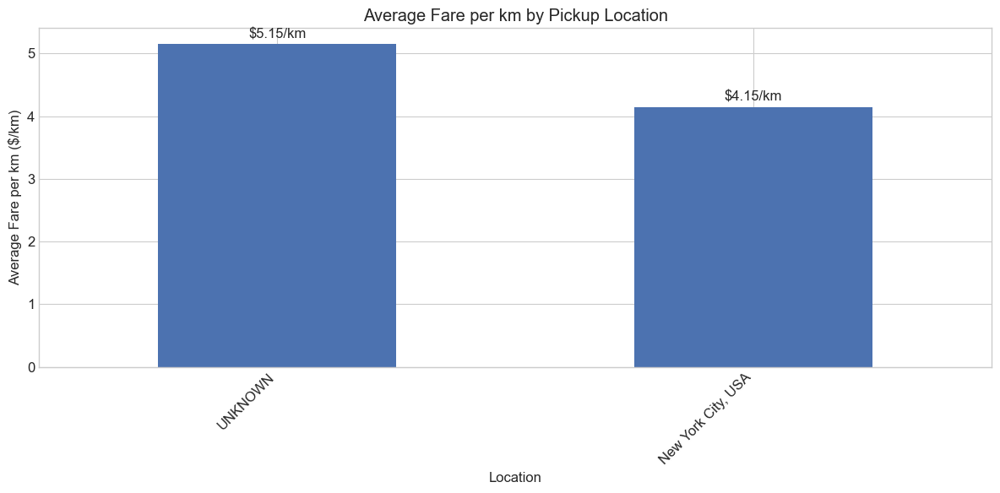

In [33]:
# 8. Average fare per km by location
plt.figure(figsize=(12, 6))
# Filter out extreme values for better visualization
filtered_df_loc = uber[(uber['fare_per_km'] > 0) & (uber['fare_per_km'] < 20)]
fare_per_km_by_location = filtered_df_loc.groupby('pickup_location')['fare_per_km'].mean().sort_values(ascending=False)
ax = fare_per_km_by_location.plot(kind='bar')
plt.title('Average Fare per km by Pickup Location')
plt.xlabel('Location')
plt.ylabel('Average Fare per km ($/km)')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()

# Add value labels on top of bars
for i, v in enumerate(fare_per_km_by_location):
    ax.text(i, v + 0.1, f'${v:.2f}/km', ha='center')

plt.show()

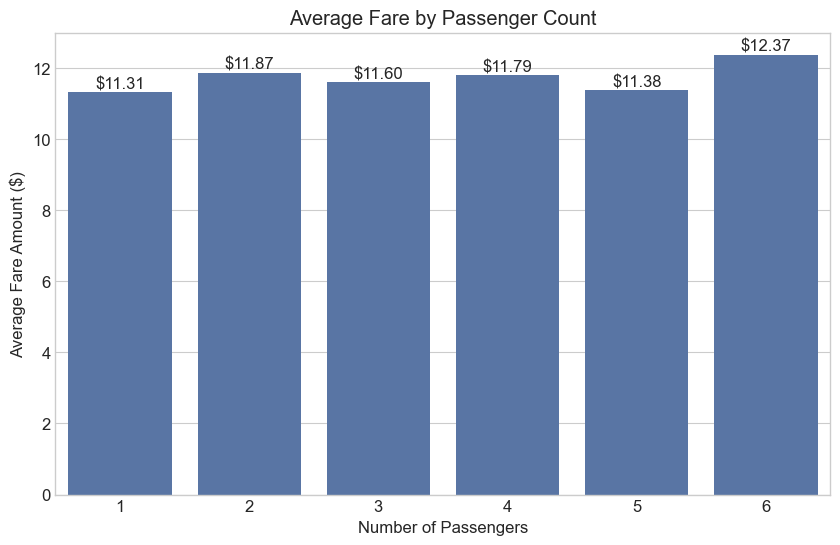

In [34]:
# 9. Average fare by passenger count
plt.figure(figsize=(10, 6))
fare_by_passenger = uber.groupby('passenger_count')['fare_amount'].mean().reset_index()
ax = sns.barplot(x='passenger_count', y='fare_amount', data=fare_by_passenger)
plt.title('Average Fare by Passenger Count')
plt.xlabel('Number of Passengers')
plt.ylabel('Average Fare Amount ($)')

# Add value labels on top of bars
for i, v in enumerate(fare_by_passenger['fare_amount']):
    ax.text(i, v + 0.1, f'${v:.2f}', ha='center')

plt.show()

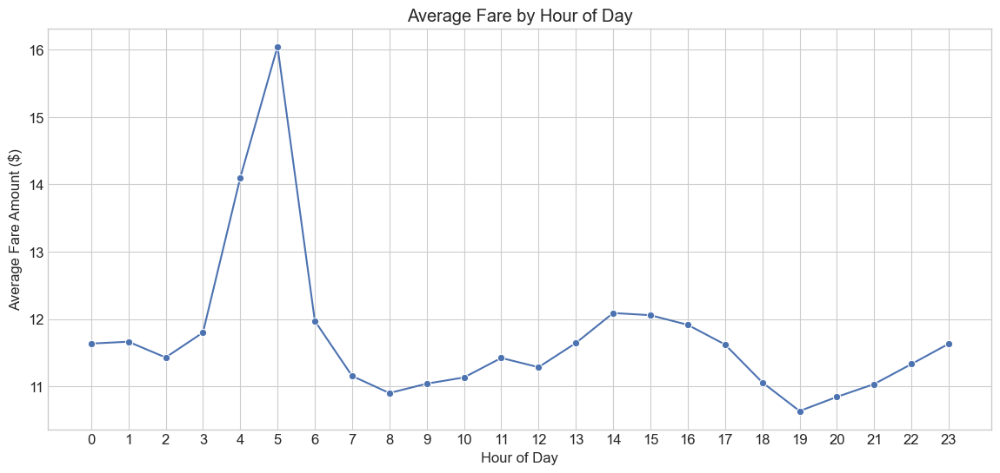

In [35]:
# 10. Average fare by hour of day
plt.figure(figsize=(14, 6))
fare_by_hour = uber.groupby('pickup_hour')['fare_amount'].mean().reset_index()
ax = sns.lineplot(x='pickup_hour', y='fare_amount', data=fare_by_hour, marker='o')
plt.title('Average Fare by Hour of Day')
plt.xlabel('Hour of Day')
plt.ylabel('Average Fare Amount ($)')
plt.xticks(range(0, 24))
plt.grid(True)
plt.show()

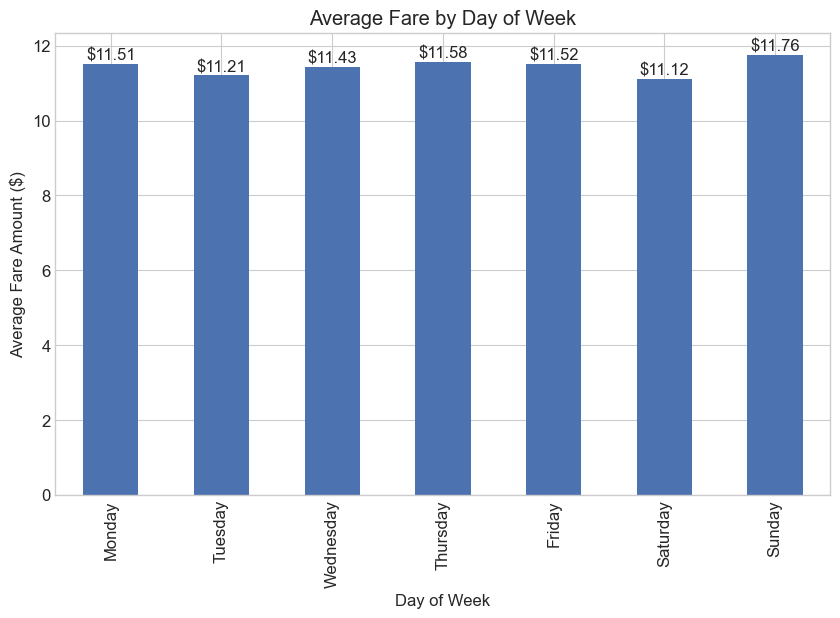

In [36]:
# 11. Average fare by day of week
plt.figure(figsize=(10, 6))
uber['pickup_weekday_name'] = uber['pickup_weekday'].map({
    0: 'Monday', 1: 'Tuesday', 2: 'Wednesday', 3: 'Thursday',
    4: 'Friday', 5: 'Saturday', 6: 'Sunday'
})
fare_by_day = uber.groupby('pickup_weekday_name')['fare_amount'].mean().reindex([
    'Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday'
])
ax = fare_by_day.plot(kind='bar')
plt.title('Average Fare by Day of Week')
plt.xlabel('Day of Week')
plt.ylabel('Average Fare Amount ($)')

# Add value labels on top of bars
for i, v in enumerate(fare_by_day):
    ax.text(i, v + 0.1, f'${v:.2f}', ha='center')

plt.show()

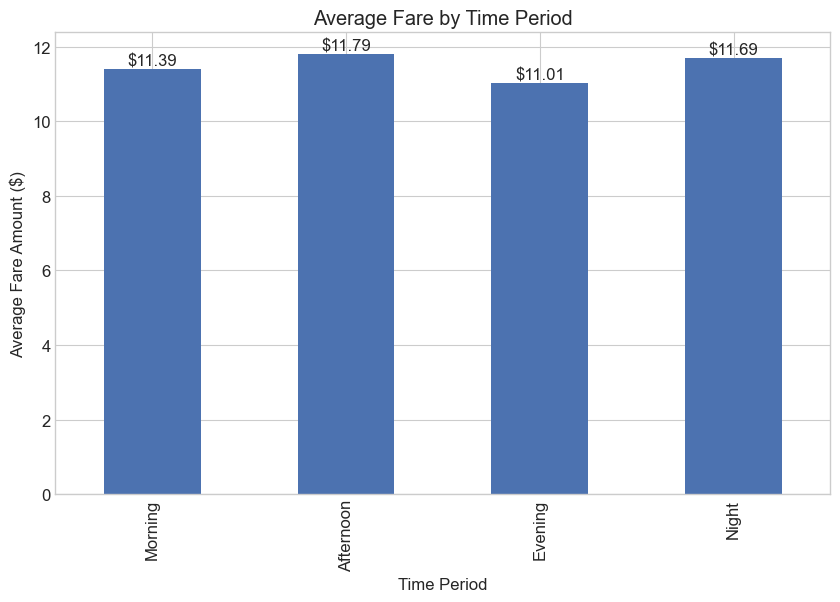

In [37]:
# 12. Average fare by time period
plt.figure(figsize=(10, 6))
fare_by_period = uber.groupby('time_period')['fare_amount'].mean().reindex(['Morning', 'Afternoon', 'Evening', 'Night'])
ax = fare_by_period.plot(kind='bar')
plt.title('Average Fare by Time Period')
plt.xlabel('Time Period')
plt.ylabel('Average Fare Amount ($)')

# Add value labels on top of bars
for i, v in enumerate(fare_by_period):
    ax.text(i, v + 0.1, f'${v:.2f}', ha='center')

plt.show()

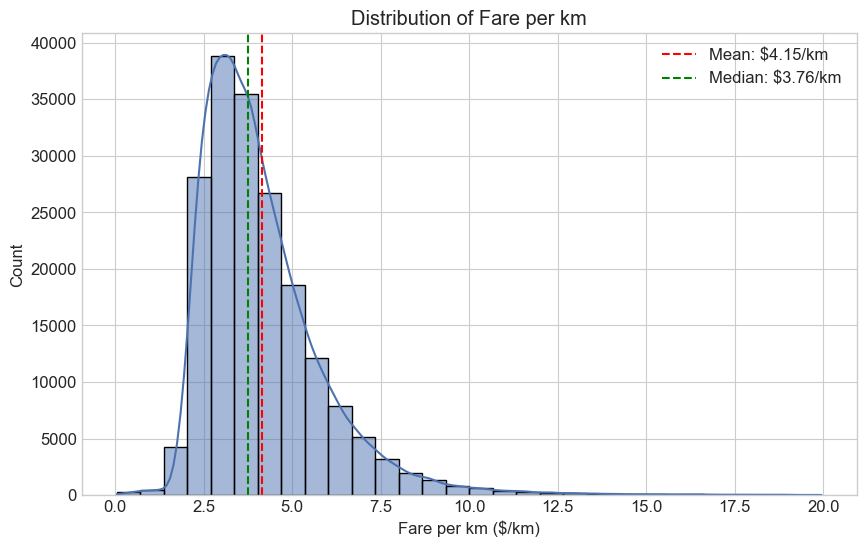

In [38]:
# 13. Distribution of fare per km
plt.figure(figsize=(10, 6))
# Filter outliers for better visualization
filtered_fare_per_km = uber[(uber['fare_per_km'] > 0) & (uber['fare_per_km'] < 20)]
sns.histplot(filtered_fare_per_km['fare_per_km'], bins=30, kde=True)
plt.title('Distribution of Fare per km')
plt.xlabel('Fare per km ($/km)')
plt.ylabel('Count')
plt.axvline(filtered_fare_per_km['fare_per_km'].mean(), color='red', linestyle='--',
           label=f'Mean: ${filtered_fare_per_km["fare_per_km"].mean():.2f}/km')
plt.axvline(filtered_fare_per_km['fare_per_km'].median(), color='green', linestyle='--',
           label=f'Median: ${filtered_fare_per_km["fare_per_km"].median():.2f}/km')
plt.legend()
plt.show()

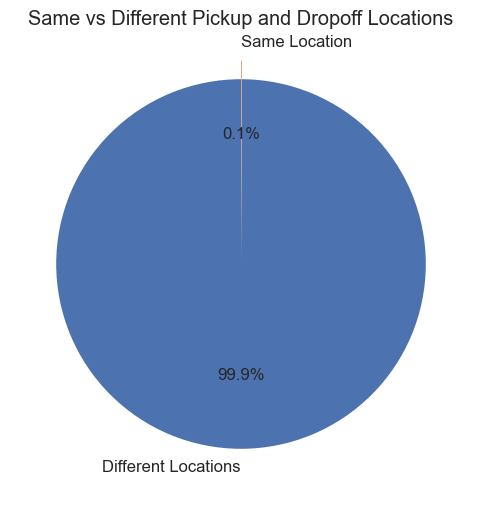

In [39]:
# 15. Same location vs different location analysis
plt.figure(figsize=(10, 6))
same_loc_counts = uber['same_location'].value_counts()
labels = ['Different Locations', 'Same Location']
plt.pie(same_loc_counts, labels=labels, autopct='%1.1f%%', startangle=90, explode=[0, 0.1])
plt.title('Same vs Different Pickup and Dropoff Locations')
plt.show()

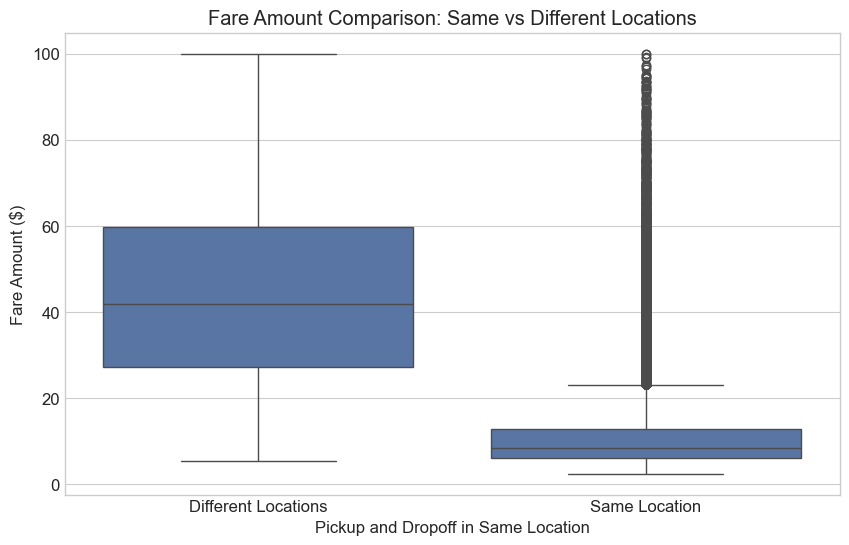

In [40]:
# 16. Compare fare amounts for same vs different locations
plt.figure(figsize=(10, 6))
sns.boxplot(x='same_location', y='fare_amount', data=uber)
plt.title('Fare Amount Comparison: Same vs Different Locations')
plt.xlabel('Pickup and Dropoff in Same Location')
plt.ylabel('Fare Amount ($)')
plt.xticks([0, 1], ['Different Locations', 'Same Location'])
plt.show()

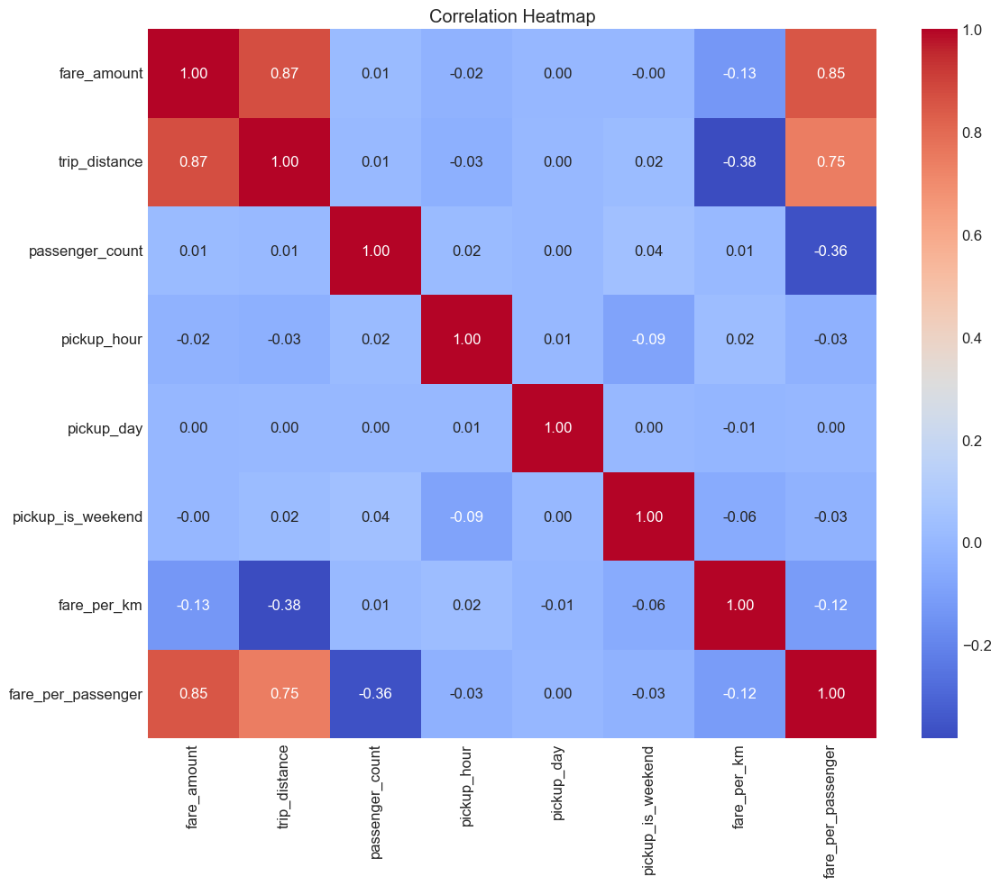

In [41]:
# 17. Heatmap of correlations
plt.figure(figsize=(12, 10))
correlation_columns = ['fare_amount', 'trip_distance', 'passenger_count',
                      'pickup_hour', 'pickup_day', 'pickup_is_weekend',
                      'fare_per_km', 'fare_per_passenger']
correlation_matrix = uber[correlation_columns].corr()
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Correlation Heatmap')
plt.tight_layout()
plt.show()

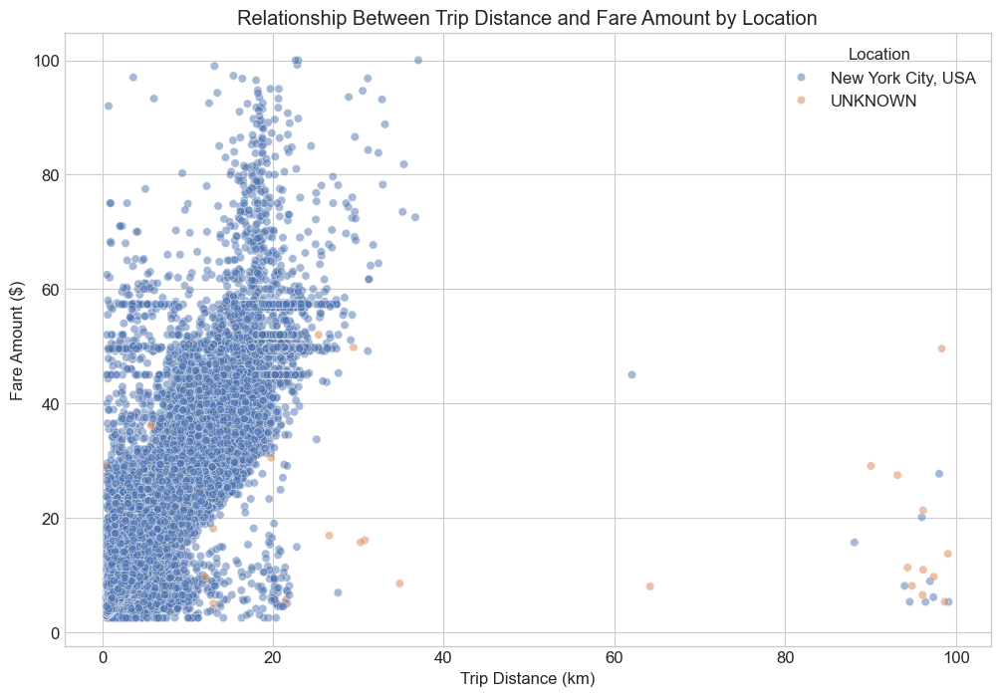

In [42]:
# 18. Relationship between distance and fare colored by location
plt.figure(figsize=(12, 8))
# Focus on locations with significant data points
top_locations = uber['pickup_location'].value_counts().nlargest(5).index.tolist()
df_top_locations = uber[uber['pickup_location'].isin(top_locations)]

sns.scatterplot(x='trip_distance', y='fare_amount', hue='pickup_location', data=df_top_locations, alpha=0.5)
plt.title('Relationship Between Trip Distance and Fare Amount by Location')
plt.xlabel('Trip Distance (km)')
plt.ylabel('Fare Amount ($)')
plt.legend(title='Location')
plt.show()

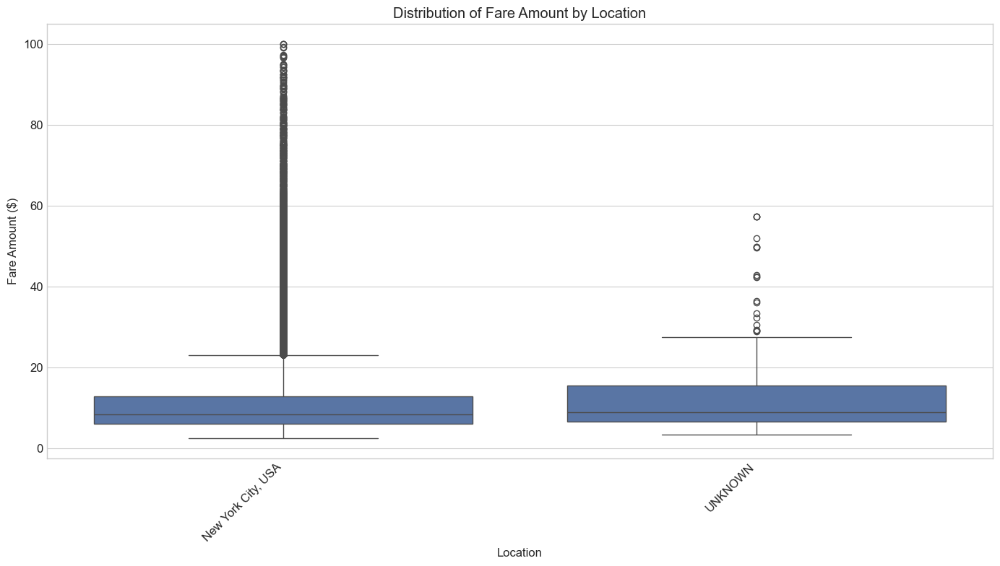

In [43]:
# 19. Box plot of fare amount by location
plt.figure(figsize=(14, 8))
# Focus on locations with significant data points
sns.boxplot(x='pickup_location', y='fare_amount', data=df_top_locations)
plt.title('Distribution of Fare Amount by Location')
plt.xlabel('Location')
plt.ylabel('Fare Amount ($)')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

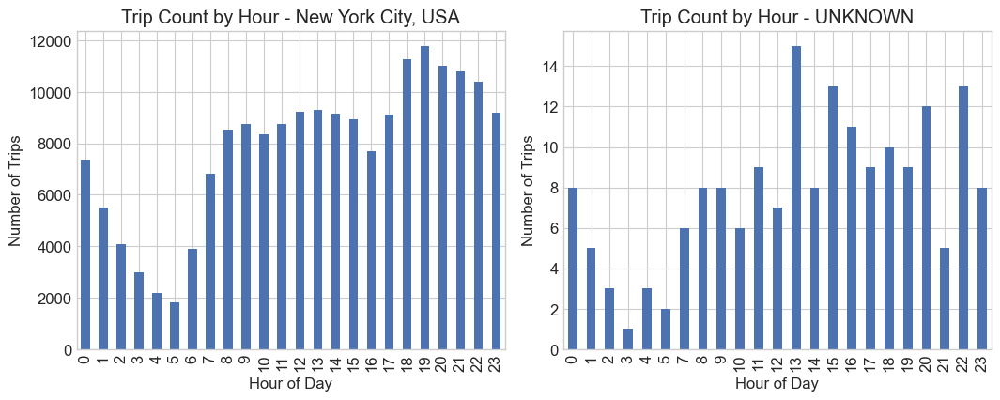

In [44]:
# 20. Trip count by hour for different locations
plt.figure(figsize=(16, 8))
for i, location in enumerate(top_locations):
    location_df = uber[uber['pickup_location'] == location]
    trip_count_by_hour = location_df['pickup_hour'].value_counts().sort_index()

    plt.subplot(2, 3, i+1)
    trip_count_by_hour.plot(kind='bar')
    plt.title(f'Trip Count by Hour - {location}')
    plt.xlabel('Hour of Day')
    plt.ylabel('Number of Trips')
    plt.tight_layout()

plt.show()

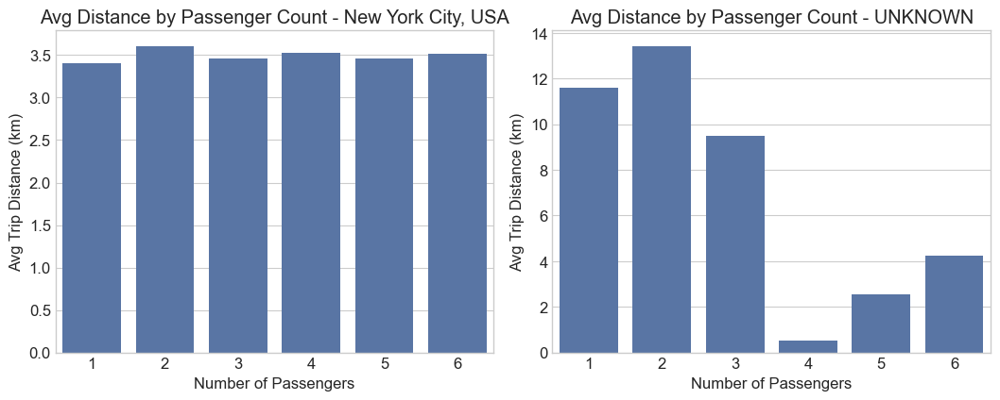

In [45]:
# 21. Average trip distance by passenger count and location
plt.figure(figsize=(16, 8))
for i, location in enumerate(top_locations):
    location_df = uber[uber['pickup_location'] == location]
    distance_by_passenger = location_df.groupby('passenger_count')['trip_distance'].mean().reset_index()

    plt.subplot(2, 3, i+1)
    sns.barplot(x='passenger_count', y='trip_distance', data=distance_by_passenger)
    plt.title(f'Avg Distance by Passenger Count - {location}')
    plt.xlabel('Number of Passengers')
    plt.ylabel('Avg Trip Distance (km)')
    plt.tight_layout()

plt.show()

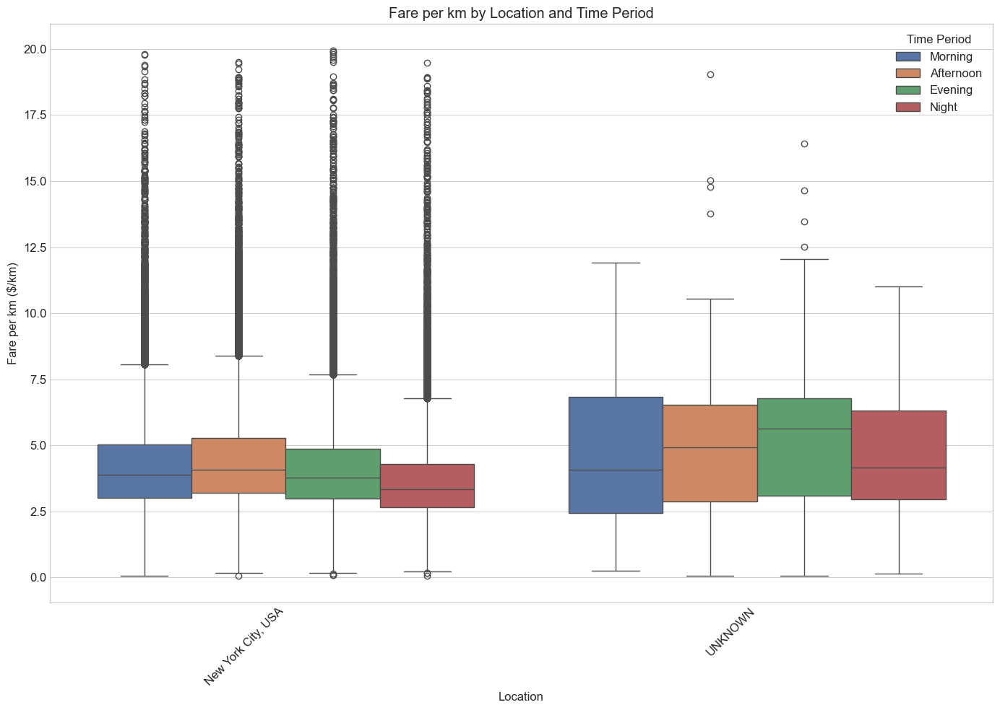

In [46]:
# 22. Average fare per km by location and time period
plt.figure(figsize=(14, 10))
# Filter out extreme values for better visualization
filtered_df_loc_time = uber[(uber['fare_per_km'] > 0) & (uber['fare_per_km'] < 20)]
filtered_df_loc_time = filtered_df_loc_time[filtered_df_loc_time['pickup_location'].isin(top_locations)]

sns.boxplot(x='pickup_location', y='fare_per_km', hue='time_period',
           data=filtered_df_loc_time, hue_order=['Morning', 'Afternoon', 'Evening', 'Night'])
plt.title('Fare per km by Location and Time Period')
plt.xlabel('Location')
plt.ylabel('Fare per km ($/km)')
plt.xticks(rotation=45, ha='right')
plt.legend(title='Time Period')
plt.tight_layout()
plt.show()

## Summary of findings

In [47]:
# Summary of findings
print("\n=== Summary of Key Findings ===")
print(f"1. Average fare amount: ${uber['fare_amount'].mean():.2f}")
print(f"2. Average trip distance: {uber['trip_distance'].mean():.2f} km")
print(f"3. Average fare per km: ${uber['fare_per_km'].mean():.2f}/km")
print(f"4. Most common passenger count: {uber['passenger_count'].mode()[0]}")
print(f"5. Correlation between distance and fare: {uber[['trip_distance', 'fare_amount']].corr().iloc[0, 1]:.3f}")
print(f"6. Percentage of weekend trips: {uber['pickup_is_weekend'].mean() * 100:.2f}%")

most_common_location = uber['pickup_location'].value_counts().idxmax()
print(f"7. Most common pickup location: {most_common_location} ({uber['pickup_location'].value_counts()[most_common_location]} trips)")

highest_fare_location = uber.groupby('pickup_location')['fare_amount'].mean().idxmax()
print(f"8. Location with highest average fare: {highest_fare_location} (${uber.groupby('pickup_location')['fare_amount'].mean()[highest_fare_location]:.2f})")

highest_fare_per_km_location = filtered_df_loc.groupby('pickup_location')['fare_per_km'].mean().idxmax()
print(f"9. Location with highest fare per km: {highest_fare_per_km_location} (${filtered_df_loc.groupby('pickup_location')['fare_per_km'].mean()[highest_fare_per_km_location]:.2f}/km)")

busiest_hour = uber['pickup_hour'].value_counts().idxmax()
print(f"10. Busiest hour of the day: {busiest_hour}:00")

highest_fare_hour = uber.groupby('pickup_hour')['fare_amount'].mean().idxmax()
print(f"11. Hour with highest average fare: {highest_fare_hour}:00 (${uber.groupby('pickup_hour')['fare_amount'].mean()[highest_fare_hour]:.2f})")

same_location_pct = uber['same_location'].mean() * 100
print(f"12. Percentage of trips with same pickup and dropoff location: {same_location_pct:.2f}%")

print("\nData is now ready for modeling with location information included!")


=== Summary of Key Findings ===
1. Average fare amount: $11.44
2. Average trip distance: 3.45 km
3. Average fare per km: $4.18/km
4. Most common passenger count: 1
5. Correlation between distance and fare: 0.875
6. Percentage of weekend trips: 28.39%
7. Most common pickup location: New York City, USA (186985 trips)
8. Location with highest average fare: UNKNOWN ($13.82)
9. Location with highest fare per km: UNKNOWN ($5.15/km)
10. Busiest hour of the day: 19:00
11. Hour with highest average fare: 5:00 ($16.05)
12. Percentage of trips with same pickup and dropoff location: 99.93%

Data is now ready for modeling with location information included!


# Data Preprocessing

## Step 1: Remove rows with _UNKNOWN_ `pickup_location` or `dropoff_location`

In [48]:

if 'pickup_location' in uber.columns and 'dropoff_location' in uber.columns:
    # Filter out UNKNOWN values
    df_clean = uber[(uber['pickup_location'] != 'UNKNOWN') & (uber['dropoff_location'] != 'UNKNOWN')]
    print(f"\nDataset shape after removing UNKNOWN locations: {df_clean.shape}")
    print(f"Removed {df.shape[0] - df_clean.shape[0]} rows")
else:
    print("\nWarning: pickup_location or dropoff_location columns not found in dataset")
    df_clean = uber.copy()



Dataset shape after removing UNKNOWN locations: (186877, 23)
Removed 16 rows


## Step 2: Handle outliers

In [49]:
# For fare_per_km which has an extremely high max value
q1 = df_clean['fare_per_km'].quantile(0.25)
q3 = df_clean['fare_per_km'].quantile(0.75)
iqr = q3 - q1
upper_bound = q3 + 3 * iqr  # Using 3*IQR for a more conservative approach

# Filter out extreme outliers
df_no_outliers = df_clean[df_clean['fare_per_km'] <= upper_bound]
print(f"\nDataset shape after removing extreme fare_per_km outliers: {df_no_outliers.shape}")
print(f"Removed {df_clean.shape[0] - df_no_outliers.shape[0]} rows")



Dataset shape after removing extreme fare_per_km outliers: (185124, 23)
Removed 1753 rows


## Step 6: Feature Engineering

### 6.1: Create time-based features

In [50]:
df_no_outliers['is_rush_hour'] = ((df_no_outliers['pickup_hour'] >= 7) & (df_no_outliers['pickup_hour'] <= 10)) | \
                               ((df_no_outliers['pickup_hour'] >= 16) & (df_no_outliers['pickup_hour'] <= 19))


### 6.2: Create fare categories for classification tasks

In [51]:
df_no_outliers['fare_category'] = pd.cut(
    df_no_outliers['fare_amount'],
    bins=4,
    labels=['Very Low', 'Low', 'Medium', 'Very High']
)


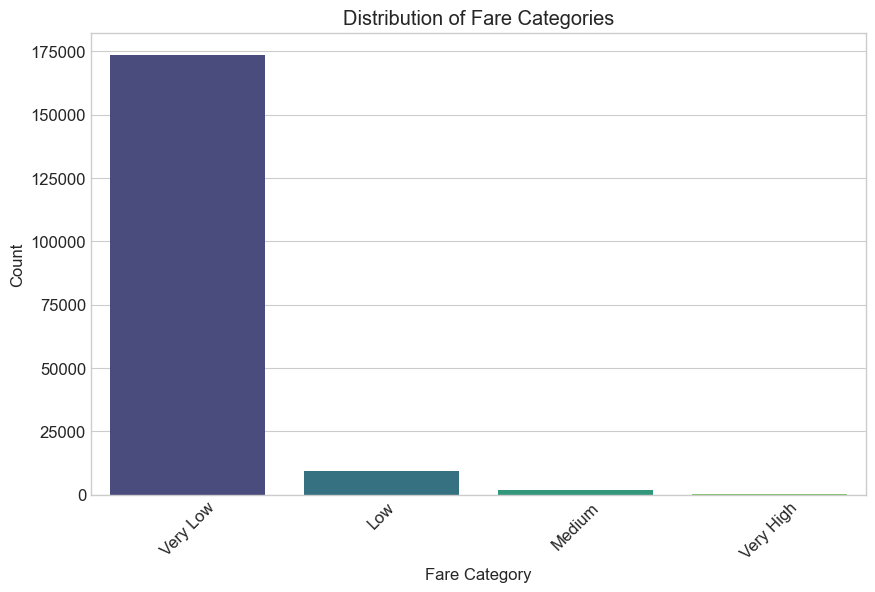

In [52]:
# plot fare category distribution
plt.figure(figsize=(10, 6))
sns.countplot(x='fare_category', data=df_no_outliers, palette='viridis')
plt.title('Distribution of Fare Categories')
plt.xlabel('Fare Category')
plt.ylabel('Count')
plt.xticks(rotation=45)
plt.show()


### 6.3: Create trip distance categories for classification tasks

In [53]:
df_no_outliers['distance_category'] = pd.qcut(df_no_outliers['trip_distance'],
                                            q=3,
                                            labels=['Short', 'Medium', 'Long'])

## Step 7: Prepare features for modeling

In [54]:
# Scale numerical features
numerical_features = [
    'pickup_longitude', 'pickup_latitude', 'dropoff_longitude', 'dropoff_latitude', 'passenger_count',
    'pickup_hour', 'pickup_day', 'pickup_month', 'pickup_year', 'pickup_weekday', 'trip_distance'
]
scaler = StandardScaler()
df_no_outliers[numerical_features] = scaler.fit_transform(df_no_outliers[numerical_features])

In [59]:
# Save the scaler for later use
joblib.dump(scaler, 'scaler.pkl')

['scaler.pkl']

In [55]:
# Drop unnecessary columns
drop_cols = ['Unnamed: 0', 'key', 'pickup_datetime', 'pickup_location',
             'dropoff_location', 'same_location', 'pickup_weekday_name']

df_no_outliers.drop(columns=drop_cols, inplace=True, errors='ignore')

## Step 8: Save the processed datasets

In [56]:
df_no_outliers.to_csv('uber_trip_data_processed.csv', index=False)
print("\nPreprocessing complete. Final dataset shape:", df_no_outliers.shape)


Preprocessing complete. Final dataset shape: (185124, 19)


In [57]:

# Display the final dataset structure
print("\nFinal dataset columns:")
print(df_no_outliers.columns.tolist())


Final dataset columns:
['fare_amount', 'pickup_longitude', 'pickup_latitude', 'dropoff_longitude', 'dropoff_latitude', 'passenger_count', 'pickup_hour', 'pickup_day', 'pickup_month', 'pickup_year', 'pickup_weekday', 'pickup_is_weekend', 'trip_distance', 'fare_per_km', 'fare_per_passenger', 'time_period', 'is_rush_hour', 'fare_category', 'distance_category']


In [58]:
df_no_outliers.T

,0,1,2,3,4,6,8,9,10,13,...,199989,199990,199991,199992,199993,199994,199996,199997,199998,199999
fare_amount,7.5,7.7,12.9,5.3,16.0,24.5,9.7,12.5,6.5,10.9,...,8.9,12.0,17.5,8.9,9.5,12.0,7.5,30.9,14.5,14.1
pickup_longitude,-0.707962,-0.547033,-0.861944,-0.009875,1.495763,0.422567,0.017732,-0.744736,0.04127,0.661078,...,0.195547,-0.333458,-0.166887,-0.817895,-0.353838,-0.214532,-0.263207,-0.301363,-0.628611,-0.253572
pickup_latitude,-0.469314,-0.850664,-0.37834,1.506961,-0.25353,-2.140563,-0.190202,-0.34005,-0.145584,0.62361,...,1.512157,-0.33603,-0.259766,-1.384545,-1.114781,0.374666,-0.526419,0.213409,-0.955052,-1.157438
dropoff_longitude,-0.737807,-0.594468,0.36511,0.282988,0.051161,3.092645,-0.833579,0.35093,-0.41167,0.068236,...,0.230539,0.673327,-1.167569,-0.485301,-0.184009,0.054445,-0.951552,3.457968,-0.251334,-0.319774
dropoff_latitude,-0.913869,-0.024293,0.708226,1.715743,0.334124,0.762372,-0.247048,0.785836,-0.697678,1.479074,...,0.513233,0.718394,-1.261127,-2.184406,-0.219121,0.102114,-0.375588,-1.918991,-1.826203,0.581753
passenger_count,-0.528374,-0.528374,-0.528374,1.005589,2.539553,2.539553,-0.528374,-0.528374,-0.528374,-0.528374,...,-0.528374,-0.528374,-0.528374,-0.528374,-0.528374,-0.528374,-0.528374,0.238608,-0.528374,-0.528374
pickup_hour,0.842779,0.995966,1.149153,-0.842279,0.536405,-0.995466,-0.689092,0.842779,0.536405,-0.382718,...,-0.995466,1.30234,-0.535905,0.383218,0.842779,0.076843,-1.914589,-2.067776,0.076843,-1.455028
pickup_day,-1.00122,0.149823,0.955552,1.185761,1.415969,-0.425699,0.149823,1.531074,0.725344,1.070657,...,0.264927,0.955552,-0.886116,1.646178,1.531074,1.761282,-0.19549,1.531074,0.495135,-0.080386
pickup_month,-0.372385,0.209105,0.499851,-0.08164,0.499851,1.081341,-1.244621,-0.953876,-0.372385,-0.08164,...,-1.244621,-0.372385,-0.08164,-1.535367,0.790596,-1.535367,-0.953876,-0.08164,-0.372385,-0.372385
pickup_year,1.747322,-1.476306,-1.476306,-1.476306,1.21005,1.21005,0.135508,0.135508,1.747322,-0.401764,...,-0.939035,1.747322,1.747322,-0.939035,0.135508,1.21005,1.21005,-1.476306,1.747322,-0.939035


# Modeling Solutions

## Part 1: Regression Models for Fare Amount Prediction

In [5]:
import pandas as pd

In [6]:
df = pd.read_csv('../uber_trip_data_processed.csv')


# Define features and target for fare amount regression
X = df.drop(['fare_amount', 'fare_category', 'distance_category', 'fare_per_km',
             'fare_per_passenger', 'time_period',], axis=1)
y = df['fare_amount']


In [7]:
X.columns

Index(['pickup_longitude', 'pickup_latitude', 'dropoff_longitude',
       'dropoff_latitude', 'passenger_count', 'pickup_hour', 'pickup_day',
       'pickup_month', 'pickup_year', 'pickup_weekday', 'pickup_is_weekend',
       'trip_distance', 'is_rush_hour'],
      dtype='object')

In [310]:
X['pickup_is_weekend'] = X['pickup_is_weekend'].astype(int)
X['is_rush_hour'] = X['is_rush_hour'].astype(int)

In [311]:
# Split data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, shuffle=True)

print(f"Training with {X_train.shape[0]} samples, testing with {X_test.shape[0]} samples")
print(f"Features: {X.columns.tolist()}")

Training with 148099 samples, testing with 37025 samples
Features: ['pickup_longitude', 'pickup_latitude', 'dropoff_longitude', 'dropoff_latitude', 'passenger_count', 'pickup_hour', 'pickup_day', 'pickup_month', 'pickup_year', 'pickup_weekday', 'pickup_is_weekend', 'trip_distance', 'is_rush_hour']


In [312]:
# Function to evaluate regression models
def evaluate_regression(model, X_train, X_test, y_train, y_test, model_name):
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)

    # Calculate metrics
    mse = mean_squared_error(y_test, y_pred)
    rmse = np.sqrt(mse)
    mae = mean_absolute_error(y_test, y_pred)
    r2 = r2_score(y_test, y_pred)

    print(f"\n{model_name} Performance:")
    print(f"Mean Squared Error: {mse:.4f}")
    print(f"Root Mean Squared Error: {rmse:.4f}")
    print(f"Mean Absolute Error: {mae:.4f}")
    print(f"R² Score: {r2:.4f}")

    # Plot actual vs predicted values
    plt.figure(figsize=(10, 6))
    plt.scatter(y_test, y_pred, alpha=0.3)
    plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r--')
    plt.xlabel('Actual Fare')
    plt.ylabel('Predicted Fare')
    plt.title(f'Actual vs Predicted Fares - {model_name}')
    plt.show()

    return model, mse, rmse, r2

### 1. Linear Regression


Linear Regression Performance:
Mean Squared Error: 11.5720
Root Mean Squared Error: 3.4018
Mean Absolute Error: 2.0302
R² Score: 0.8612


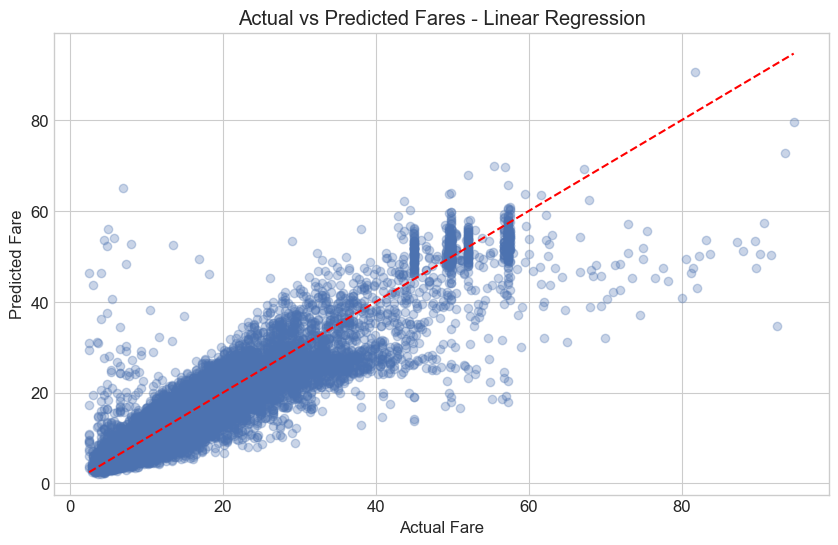

In [313]:
lr_model = LinearRegression()
lr_model, lr_mse, lr_rmse, lr_r2 = evaluate_regression(
    lr_model, X_train, X_test, y_train, y_test, "Linear Regression")

### 2. Decision Tree Regressor


Decision Tree Regressor Performance:
Mean Squared Error: 14.5313
Root Mean Squared Error: 3.8120
Mean Absolute Error: 2.2097
R² Score: 0.8257


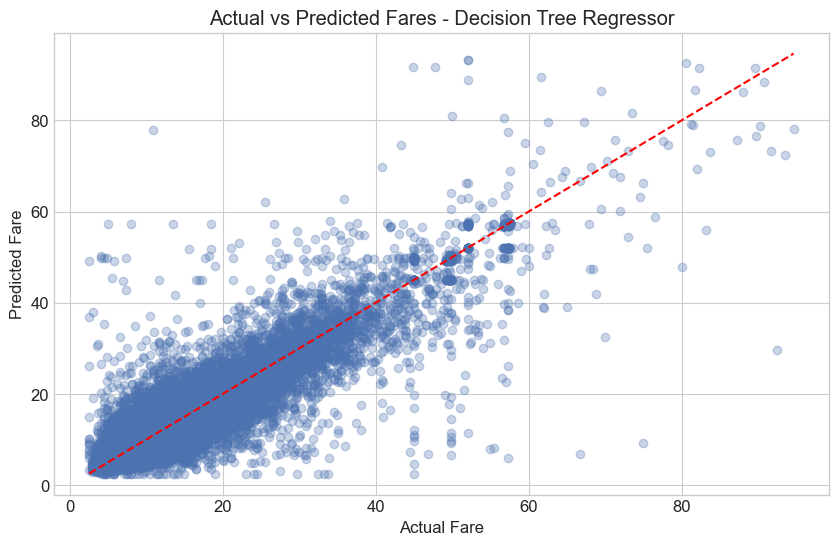

In [314]:
dt_model = DecisionTreeRegressor(random_state=42)
dt_model, dt_mse, dt_rmse, dt_r2 = evaluate_regression(
    dt_model, X_train, X_test, y_train, y_test, "Decision Tree Regressor")

### 3. Random Forest Regressor


Random Forest Regressor Performance:
Mean Squared Error: 7.1406
Root Mean Squared Error: 2.6722
Mean Absolute Error: 1.5462
R² Score: 0.9143


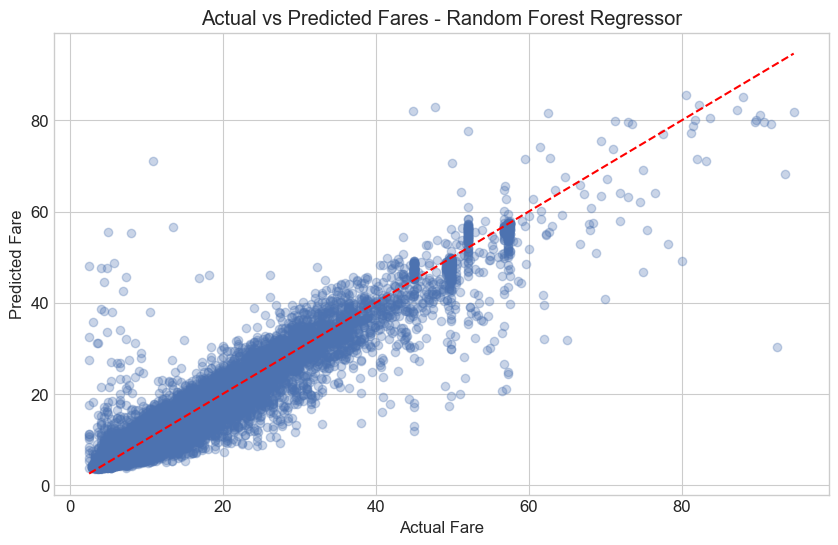

In [315]:
rf_model = RandomForestRegressor(n_estimators=100, random_state=42)
rf_model, rf_mse, rf_rmse, rf_r2 = evaluate_regression(
    rf_model, X_train, X_test, y_train, y_test, "Random Forest Regressor")

### 4. Gradient Boosting Regressor


Gradient Boosting Regressor Performance:
Mean Squared Error: 7.9326
Root Mean Squared Error: 2.8165
Mean Absolute Error: 1.6765
R² Score: 0.9048


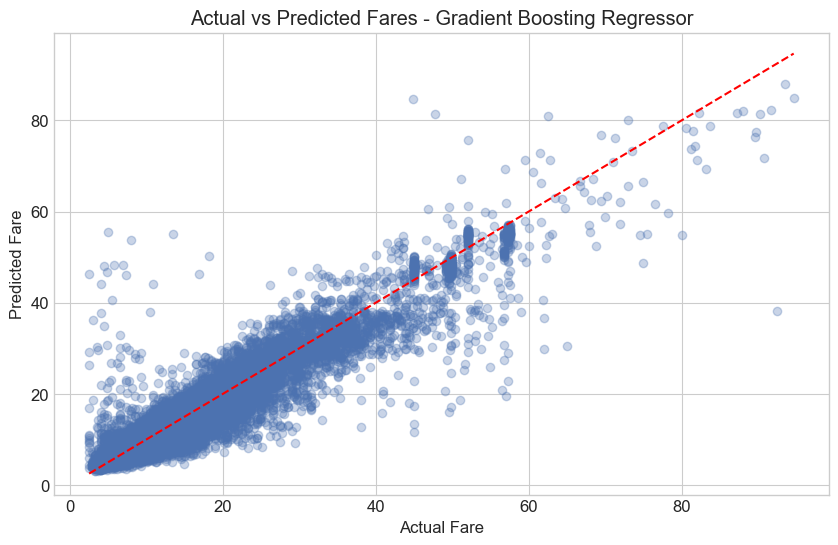

In [316]:
gb_model = GradientBoostingRegressor(n_estimators=100, random_state=42)
gb_model, gb_mse, gb_rmse, gb_r2 = evaluate_regression(
    gb_model, X_train, X_test, y_train, y_test, "Gradient Boosting Regressor")

### 5. Feature Importance for the best performing model (Random Forest or Gradient Boosting)

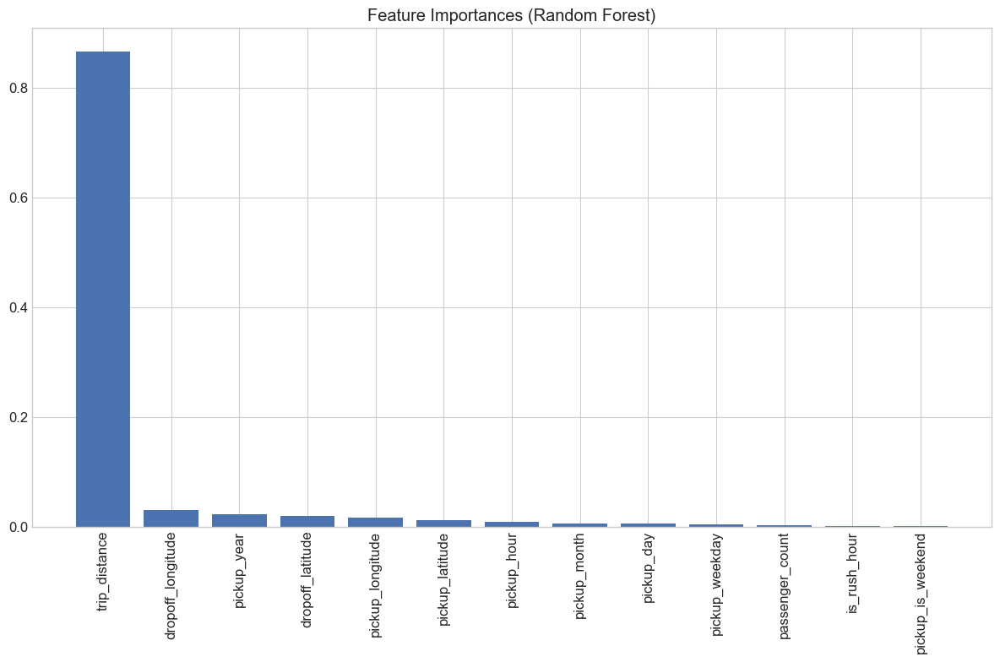

In [317]:
best_model = rf_model if rf_r2 > gb_r2 else gb_model
best_model_name = "Random Forest" if rf_r2 > gb_r2 else "Gradient Boosting"

# Get feature importances
importances = best_model.feature_importances_
indices = np.argsort(importances)[::-1]

# Plot feature importances
plt.figure(figsize=(12, 8))
plt.title(f'Feature Importances ({best_model_name})')
plt.bar(range(X.shape[1]), importances[indices], align='center')
plt.xticks(range(X.shape[1]), X.columns[indices], rotation=90)
plt.tight_layout()
plt.show()

## Part 2: Classification Models for Fare Category

In [321]:
# Define features and target for fare category classification
X_class = df.drop(['fare_amount', 'fare_category', 'distance_category', 'fare_per_km',
                  'fare_per_passenger', 'time_period'], axis=1)
y_class = df['fare_category']

In [322]:
X_class['pickup_is_weekend'] = X_class['pickup_is_weekend'].astype(int)
X_class['is_rush_hour'] = X_class['is_rush_hour'].astype(int)

In [323]:
# Split data
X_train_class, X_test_class, y_train_class, y_test_class = train_test_split(
    X_class, y_class, test_size=0.2, random_state=42)

# Function to evaluate classification models
def evaluate_classification(model, X_train, X_test, y_train, y_test, model_name):
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)

    # Calculate metrics
    accuracy = accuracy_score(y_test, y_pred)
    clf_report = classification_report(y_test, y_pred)

    print(f"\n{model_name} Performance:")
    print(f"Accuracy: {accuracy:.4f}")
    print("Classification Report:")
    print(clf_report)

    # Plot confusion matrix
    cm = confusion_matrix(y_test, y_pred)
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
                xticklabels=model.classes_, yticklabels=model.classes_)
    plt.xlabel('Predicted')
    plt.ylabel('Actual')
    plt.title(f'Confusion Matrix - {model_name}')
    plt.show()

    return model, accuracy

### 1. Logistic Regression


Logistic Regression Performance:
Accuracy: 0.9751
Classification Report:
              precision    recall  f1-score   support

         Low       0.79      0.72      0.76      1883
      Medium       0.78      0.72      0.75       384
   Very High       0.25      0.14      0.18        22
    Very Low       0.99      0.99      0.99     34736

    accuracy                           0.98     37025
   macro avg       0.70      0.64      0.67     37025
weighted avg       0.97      0.98      0.97     37025



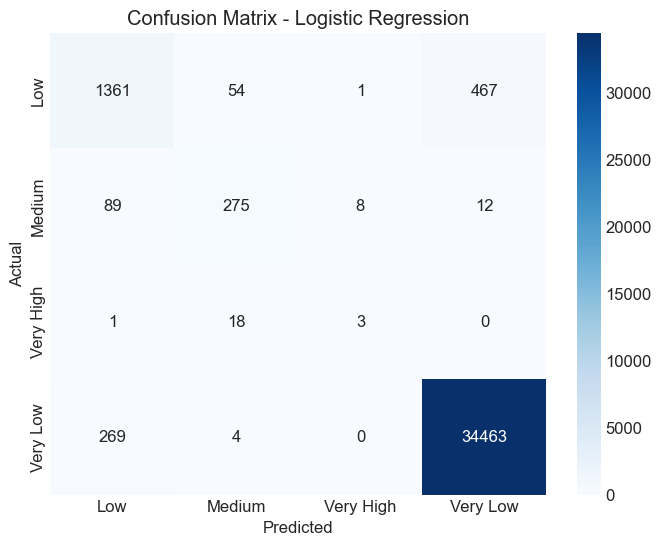

In [324]:
log_reg_model = LogisticRegression(max_iter=1000, random_state=42)
log_reg_model, log_reg_acc = evaluate_classification(
    log_reg_model, X_train_class, X_test_class, y_train_class, y_test_class, "Logistic Regression")

### 2. Decision Tree Classifier


Decision Tree Classifier Performance:
Accuracy: 0.9763
Classification Report:
              precision    recall  f1-score   support

         Low       0.77      0.78      0.78      1883
      Medium       0.81      0.80      0.81       384
   Very High       0.56      0.68      0.61        22
    Very Low       0.99      0.99      0.99     34736

    accuracy                           0.98     37025
   macro avg       0.78      0.81      0.80     37025
weighted avg       0.98      0.98      0.98     37025



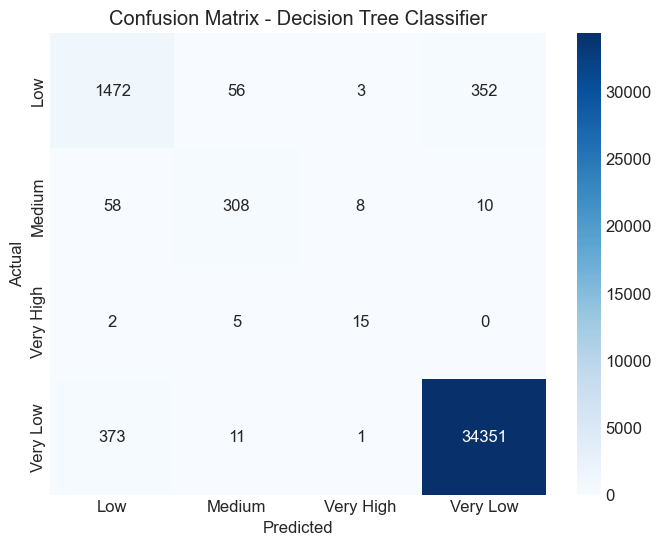

In [325]:
dt_clf_model = DecisionTreeClassifier(random_state=42)
dt_clf_model, dt_clf_acc = evaluate_classification(
    dt_clf_model, X_train_class, X_test_class, y_train_class, y_test_class, "Decision Tree Classifier")

### 3. Random Forest Classifier


Random Forest Classifier Performance:
Accuracy: 0.9838
Classification Report:
              precision    recall  f1-score   support

         Low       0.85      0.84      0.84      1883
      Medium       0.95      0.82      0.88       384
   Very High       0.70      0.64      0.67        22
    Very Low       0.99      0.99      0.99     34736

    accuracy                           0.98     37025
   macro avg       0.87      0.82      0.84     37025
weighted avg       0.98      0.98      0.98     37025



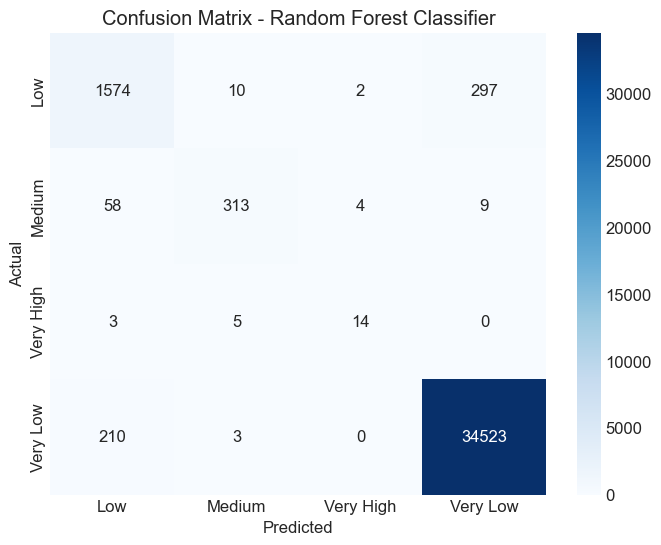

In [326]:
rf_clf_model = RandomForestClassifier(n_estimators=100, random_state=42)
rf_clf_model, rf_clf_acc = evaluate_classification(
    rf_clf_model, X_train_class, X_test_class, y_train_class, y_test_class, "Random Forest Classifier")


## Part 3: Classification Models for Trip Distance Category

In [327]:
# Define features and target for distance category classification
# Here we exclude trip_distance since it directly determines the category
X_dist = df.drop(['fare_amount', 'fare_category', 'distance_category', 'fare_per_km',
                 'fare_per_passenger', 'trip_distance', 'time_period'], axis=1)
y_dist = df['distance_category']

# Split data
X_train_dist, X_test_dist, y_train_dist, y_test_dist = train_test_split(
    X_dist, y_dist, test_size=0.2, random_state=42)


Random Forest for Distance Category Performance:
Accuracy: 0.9325
Classification Report:
              precision    recall  f1-score   support

        Long       0.97      0.96      0.96     12363
      Medium       0.90      0.89      0.90     12313
       Short       0.92      0.95      0.93     12349

    accuracy                           0.93     37025
   macro avg       0.93      0.93      0.93     37025
weighted avg       0.93      0.93      0.93     37025



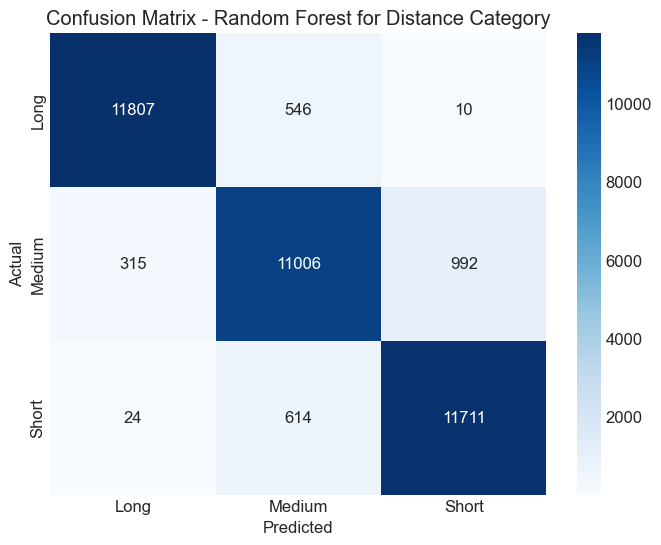

In [328]:
# Evaluate Random Forest Classifier for distance prediction
rf_dist_model = RandomForestClassifier(n_estimators=100, random_state=42)
rf_dist_model, rf_dist_acc = evaluate_classification(
    rf_dist_model, X_train_dist, X_test_dist, y_train_dist, y_test_dist,
    "Random Forest for Distance Category")

## Part 4: Advanced Model - XGBoost for Fare Prediction


XGBoost Regressor Performance:
Mean Squared Error: 7.1766
Root Mean Squared Error: 2.6789
Mean Absolute Error: 1.5712
R² Score: 0.9139


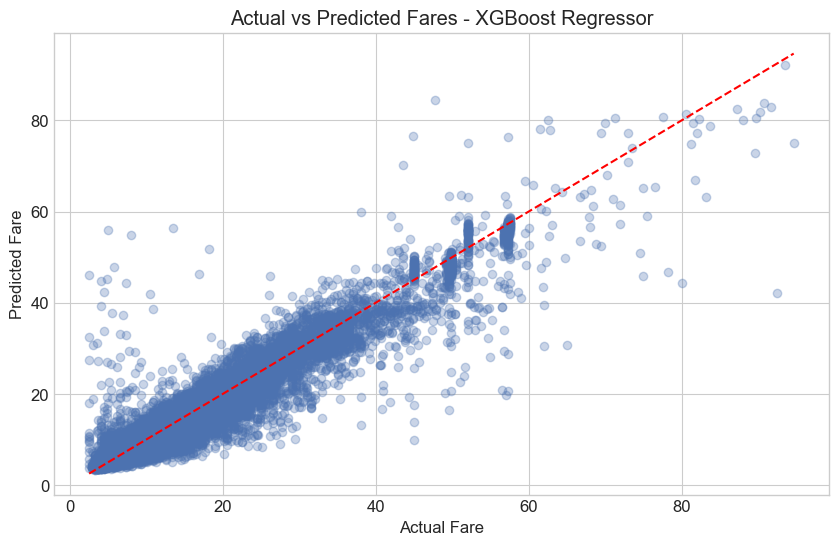

<Figure size 1200x800 with 0 Axes>

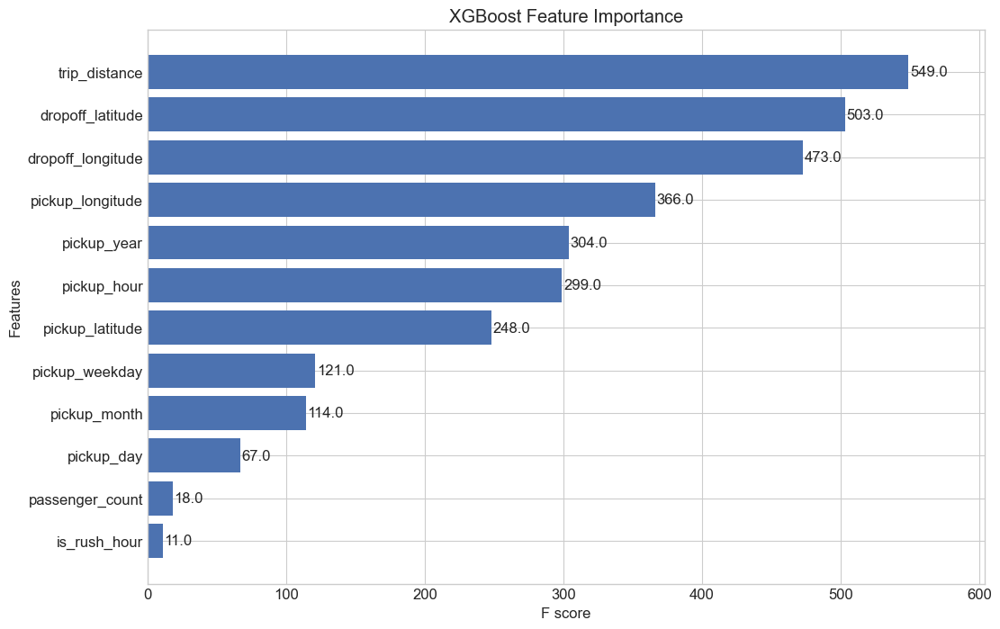

In [329]:
try:
    import xgboost as xgb

    # Create an XGBoost regressor
    xgb_model = xgb.XGBRegressor(
        objective='reg:squarederror',
        n_estimators=100,
        learning_rate=0.1,
        max_depth=5,
        random_state=42
    )

    # Evaluate XGBoost
    xgb_model, xgb_mse, xgb_rmse, xgb_r2 = evaluate_regression(
        xgb_model, X_train, X_test, y_train, y_test, "XGBoost Regressor")

    # Feature importance
    plt.figure(figsize=(12, 8))
    xgb.plot_importance(xgb_model, height=0.8, max_num_features=15)
    plt.title('XGBoost Feature Importance')
    plt.show()

except ImportError:
    print("XGBoost not installed. Skipping XGBoost analysis.")



## Part 5: Model Comparison & Summary


===== Regression Models Summary =====
Best Regression Model: Random Forest with RMSE of 2.6722


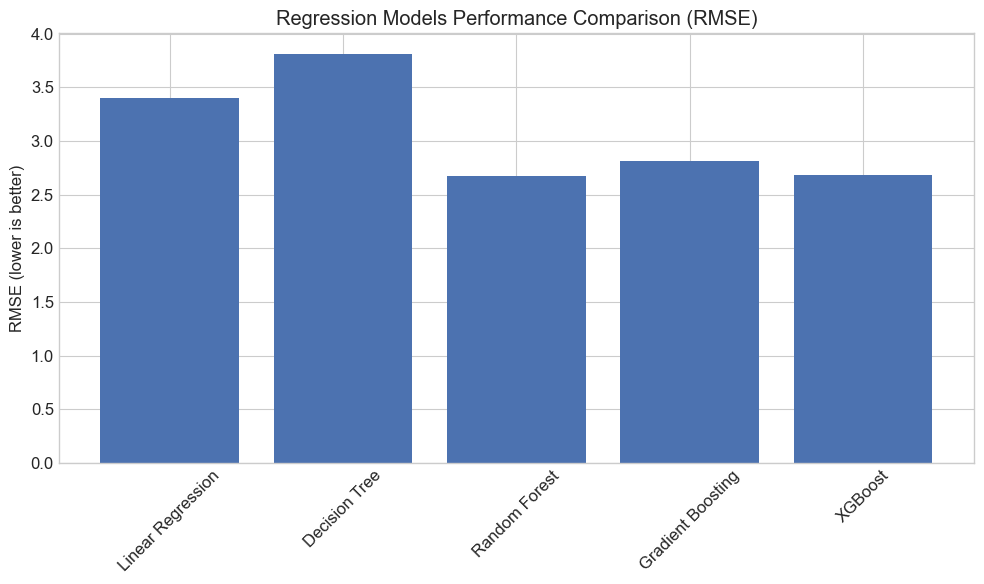

In [330]:
print("\n===== Regression Models Summary =====")
models_comparison = {
    'Linear Regression': lr_rmse,
    'Decision Tree': dt_rmse,
    'Random Forest': rf_rmse,
    'Gradient Boosting': gb_rmse
}
try:
    models_comparison['XGBoost'] = xgb_rmse
except NameError:
    pass

# Find best model
best_model = min(models_comparison.items(), key=lambda x: x[1])
print(f"Best Regression Model: {best_model[0]} with RMSE of {best_model[1]:.4f}")

# Plot model comparison
plt.figure(figsize=(10, 6))
plt.bar(models_comparison.keys(), models_comparison.values())
plt.title('Regression Models Performance Comparison (RMSE)')
plt.ylabel('RMSE (lower is better)')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


===== Classification Models Summary =====
Best Classification Model: Random Forest with accuracy of 0.9838


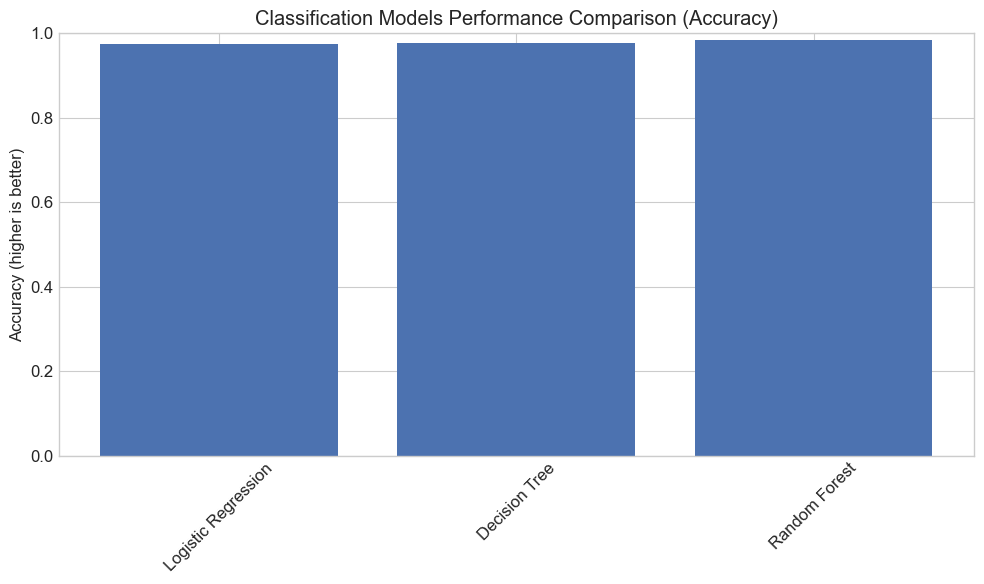

In [333]:
print("\n===== Classification Models Summary =====")
clf_comparison = {
    'Logistic Regression': log_reg_acc,
    'Decision Tree': dt_clf_acc,
    'Random Forest': rf_clf_acc,
}

# Find best classification model
best_clf = max(clf_comparison.items(), key=lambda x: x[1])
print(f"Best Classification Model: {best_clf[0]} with accuracy of {best_clf[1]:.4f}")

# Plot model comparison
plt.figure(figsize=(10, 6))
plt.bar(clf_comparison.keys(), clf_comparison.values())
plt.title('Classification Models Performance Comparison (Accuracy)')
plt.ylabel('Accuracy (higher is better)')
plt.ylim(0, 1.0)
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

# Hyperparameter Tuning

## Part 1: Tune Random Forest Regressor

In [337]:
# Define features and target for fare amount regression
X = df.drop(['fare_amount', 'fare_category', 'distance_category', 'fare_per_km',
             'fare_per_passenger', 'time_period'], axis=1)
y = df['fare_amount']

# Split data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Define parameter grid
param_grid_rf = {
    'n_estimators': [50, 200],
    'max_depth': [10,  30],
    'min_samples_split': [5, 10],
    'min_samples_leaf': [2, 4],
    'bootstrap': [True, False]
}

In [338]:
# Use randomized search for efficiency
rf_random = RandomizedSearchCV(
    estimator=RandomForestRegressor(random_state=42),
    param_distributions=param_grid_rf,
    n_iter=20,  # Number of parameter settings sampled
    cv=3,
    verbose=1,
    random_state=42,
    n_jobs=-1
)

# Fit the randomized search
start_time = time.time()
rf_random.fit(X_train, y_train)
tuning_time = time.time() - start_time

print(f"Random Forest tuning completed in {tuning_time:.2f} seconds")
print(f"Best parameters: {rf_random.best_params_}")
print(f"Best cross-validation score: {rf_random.best_score_:.4f}")

Fitting 3 folds for each of 20 candidates, totalling 60 fits
Random Forest tuning completed in 1835.12 seconds
Best parameters: {'n_estimators': 200, 'min_samples_split': 5, 'min_samples_leaf': 4, 'max_depth': 30, 'bootstrap': True}
Best cross-validation score: 0.9159


In [339]:
# Evaluate on test set
best_rf = rf_random.best_estimator_
y_pred_rf = best_rf.predict(X_test)
rf_mse = mean_squared_error(y_test, y_pred_rf)
rf_rmse = np.sqrt(rf_mse)
rf_r2 = r2_score(y_test, y_pred_rf)

print(f"Test set RMSE: {rf_rmse:.4f}")
print(f"Test set R²: {rf_r2:.4f}")

Test set RMSE: 2.6432
Test set R²: 0.9162


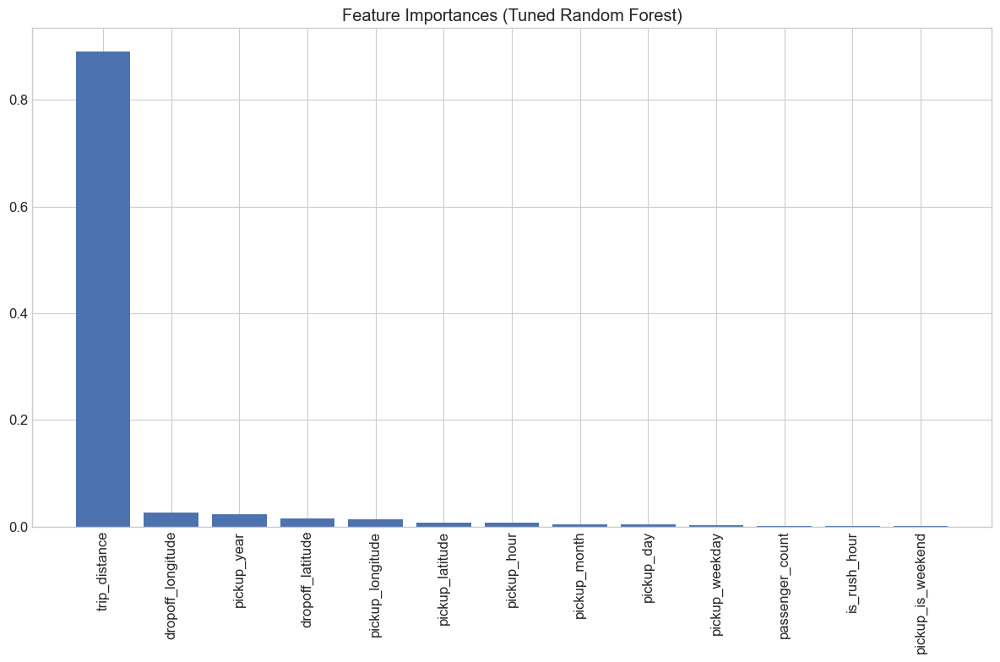

In [340]:
# Save the best model
joblib.dump(best_rf, 'best_random_forest_regressor.pkl')

# Feature importance visualization
feature_importances = best_rf.feature_importances_
feature_names = X.columns
indices = np.argsort(feature_importances)[::-1]

plt.figure(figsize=(12, 8))
plt.title('Feature Importances (Tuned Random Forest)')
plt.bar(range(X.shape[1]), feature_importances[indices], align='center')
plt.xticks(range(X.shape[1]), [feature_names[i] for i in indices], rotation=90)
plt.tight_layout()
plt.show()


## Part 2: Tune Gradient Boosting Regressor

In [341]:
# Define parameter grid
param_grid_gb = {
    'n_estimators': [50, 200],
    'learning_rate': [0.01, 0.2],
    'max_depth': [3, 7],
    'min_samples_split': [2, 10],
}

# Use randomized search for efficiency
gb_random = RandomizedSearchCV(
    estimator=GradientBoostingRegressor(random_state=42),
    param_distributions=param_grid_gb,
    n_iter=20,  # Number of parameter settings sampled
    cv=3,
    verbose=1,
    random_state=42,
    n_jobs=-1
)

# Fit the randomized search
start_time = time.time()
gb_random.fit(X_train, y_train)
tuning_time = time.time() - start_time

print(f"Gradient Boosting tuning completed in {tuning_time:.2f} seconds")
print(f"Best parameters: {gb_random.best_params_}")
print(f"Best cross-validation score: {gb_random.best_score_:.4f}")

Fitting 3 folds for each of 16 candidates, totalling 48 fits
Gradient Boosting tuning completed in 776.25 seconds
Best parameters: {'n_estimators': 200, 'min_samples_split': 10, 'max_depth': 7, 'learning_rate': 0.2}
Best cross-validation score: 0.9243


In [342]:
# Evaluate on test set
best_gb = gb_random.best_estimator_
y_pred_gb = best_gb.predict(X_test)
gb_mse = mean_squared_error(y_test, y_pred_gb)
gb_rmse = np.sqrt(gb_mse)
gb_r2 = r2_score(y_test, y_pred_gb)

print(f"Test set RMSE: {gb_rmse:.4f}")
print(f"Test set R²: {gb_r2:.4f}")

# Save the best model
joblib.dump(best_gb, 'best_gradient_boosting_regressor.pkl')

Test set RMSE: 2.5428
Test set R²: 0.9224


['best_gradient_boosting_regressor.pkl']

## Part 3: Tune Random Forest Classifier

In [343]:
# Define features and target for fare category classification
X_class = df.drop(['fare_amount', 'fare_category', 'distance_category', 'fare_per_km',
                  'fare_per_passenger', 'time_period'], axis=1)
y_class = df['fare_category']

# Split data
X_train_class, X_test_class, y_train_class, y_test_class = train_test_split(
    X_class, y_class, test_size=0.2, random_state=42)

# Define parameter grid
param_grid_rf_clf = {
    'n_estimators': [50, 200],
    'max_depth': [10,  30],
    'min_samples_split': [5, 10],
    'min_samples_leaf': [2, 4],
    'bootstrap': [True, False],
    'class_weight': ['balanced', 'balanced_subsample']
}

# Use randomized search for efficiency
rf_clf_random = RandomizedSearchCV(
    estimator=RandomForestClassifier(random_state=42),
    param_distributions=param_grid_rf_clf,
    n_iter=20,  # Number of parameter settings sampled
    cv=3,
    verbose=2,
    random_state=42,
    n_jobs=-1
)

# Fit the randomized search
start_time = time.time()
rf_clf_random.fit(X_train_class, y_train_class)
tuning_time = time.time() - start_time

print(f"Random Forest Classifier tuning completed in {tuning_time:.2f} seconds")
print(f"Best parameters: {rf_clf_random.best_params_}")
print(f"Best cross-validation score: {rf_clf_random.best_score_:.4f}")

Fitting 3 folds for each of 20 candidates, totalling 60 fits
Random Forest Classifier tuning completed in 350.46 seconds
Best parameters: {'n_estimators': 50, 'min_samples_split': 5, 'min_samples_leaf': 2, 'max_depth': 30, 'class_weight': 'balanced_subsample', 'bootstrap': False}
Best cross-validation score: 0.9832


Test set accuracy: 0.9835
Classification report:
              precision    recall  f1-score   support

         Low       0.82      0.87      0.85      1883
      Medium       0.92      0.85      0.88       384
   Very High       0.71      0.68      0.70        22
    Very Low       0.99      0.99      0.99     34736

    accuracy                           0.98     37025
   macro avg       0.86      0.85      0.85     37025
weighted avg       0.98      0.98      0.98     37025



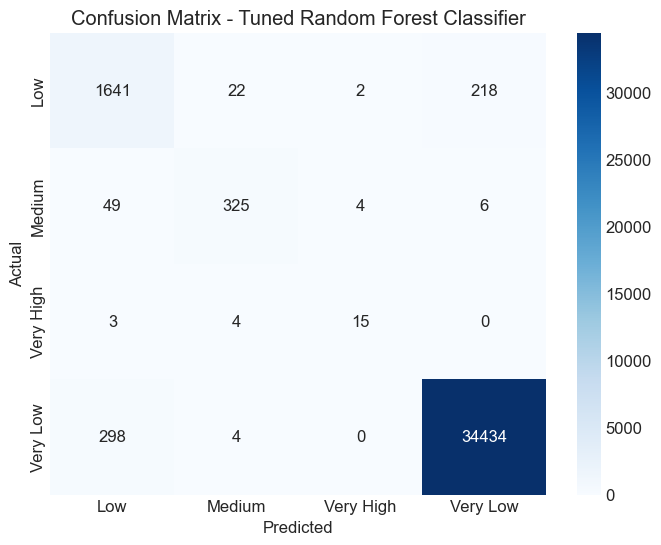

In [344]:
# Evaluate on test set
best_rf_clf = rf_clf_random.best_estimator_
y_pred_rf_clf = best_rf_clf.predict(X_test_class)
rf_clf_accuracy = accuracy_score(y_test_class, y_pred_rf_clf)
rf_clf_report = classification_report(y_test_class, y_pred_rf_clf)

print(f"Test set accuracy: {rf_clf_accuracy:.4f}")
print("Classification report:")
print(rf_clf_report)

# Save the best model
joblib.dump(best_rf_clf, 'best_random_forest_classifier.pkl')

cm = confusion_matrix(y_test_class, y_pred_rf_clf)
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=best_rf_clf.classes_, yticklabels=best_rf_clf.classes_)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix - Tuned Random Forest Classifier')
plt.show()

## Part 4: Compare original and tuned models

In [345]:
# Initialize original models
original_rf = RandomForestRegressor(random_state=42)
original_gb = GradientBoostingRegressor(random_state=42)
original_rf_clf = RandomForestClassifier(random_state=42)

In [346]:
# Fit original models
original_rf.fit(X_train, y_train)
original_gb.fit(X_train, y_train)
original_rf_clf.fit(X_train_class, y_train_class)

RandomForestClassifier(random_state=42)

In [347]:
# Evaluate original models
y_pred_original_rf = original_rf.predict(X_test)
original_rf_rmse = np.sqrt(mean_squared_error(y_test, y_pred_original_rf))
original_rf_r2 = r2_score(y_test, y_pred_original_rf)

y_pred_original_gb = original_gb.predict(X_test)
original_gb_rmse = np.sqrt(mean_squared_error(y_test, y_pred_original_gb))
original_gb_r2 = r2_score(y_test, y_pred_original_gb)

y_pred_original_rf_clf = original_rf_clf.predict(X_test_class)
original_rf_clf_accuracy = accuracy_score(y_test_class, y_pred_original_rf_clf)

In [348]:
# Print comparison results
print("\nModel Performance Comparison:")
print("\nRandom Forest Regressor:")
print(f"Original - RMSE: {original_rf_rmse:.4f}, R²: {original_rf_r2:.4f}")
print(f"Tuned    - RMSE: {rf_rmse:.4f}, R²: {rf_r2:.4f}")
print(f"Improvement - RMSE: {original_rf_rmse - rf_rmse:.4f} ({((original_rf_rmse - rf_rmse) / original_rf_rmse * 100):.2f}%), "
      f"R²: {rf_r2 - original_rf_r2:.4f} ({((rf_r2 - original_rf_r2) / original_rf_r2 * 100):.2f}%)")

print("\nGradient Boosting Regressor:")
print(f"Original - RMSE: {original_gb_rmse:.4f}, R²: {original_gb_r2:.4f}")
print(f"Tuned    - RMSE: {gb_rmse:.4f}, R²: {gb_r2:.4f}")
print(f"Improvement - RMSE: {original_gb_rmse - gb_rmse:.4f} ({((original_gb_rmse - gb_rmse) / original_gb_rmse * 100):.2f}%), "
      f"R²: {gb_r2 - original_gb_r2:.4f} ({((gb_r2 - original_gb_r2) / original_gb_r2 * 100):.2f}%)")

print("\nRandom Forest Classifier:")
print(f"Original - Accuracy: {original_rf_clf_accuracy:.4f}")
print(f"Tuned    - Accuracy: {rf_clf_accuracy:.4f}")
print(f"Improvement - Accuracy: {rf_clf_accuracy - original_rf_clf_accuracy:.4f} "
      f"({((rf_clf_accuracy - original_rf_clf_accuracy) / original_rf_clf_accuracy * 100):.2f}%)")



Model Performance Comparison:

Random Forest Regressor:
Original - RMSE: 2.6722, R²: 0.9143
Tuned    - RMSE: 2.6432, R²: 0.9162
Improvement - RMSE: 0.0290 (1.08%), R²: 0.0018 (0.20%)

Gradient Boosting Regressor:
Original - RMSE: 2.8165, R²: 0.9048
Tuned    - RMSE: 2.5428, R²: 0.9224
Improvement - RMSE: 0.2736 (9.72%), R²: 0.0176 (1.94%)

Random Forest Classifier:
Original - Accuracy: 0.9838
Tuned    - Accuracy: 0.9835
Improvement - Accuracy: -0.0002 (-0.02%)


## Part 5: Visualize model comparison

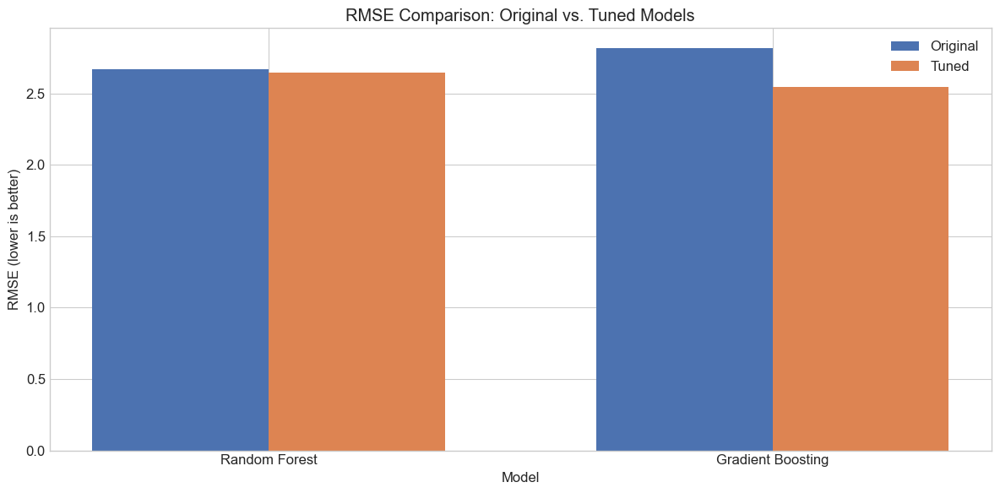

In [349]:
# Create bar chart comparing RMSE values
plt.figure(figsize=(12, 6))
models = ['Random Forest', 'Gradient Boosting']
original_rmse = [original_rf_rmse, original_gb_rmse]
tuned_rmse = [rf_rmse, gb_rmse]

x = np.arange(len(models))
width = 0.35

plt.bar(x - width/2, original_rmse, width, label='Original')
plt.bar(x + width/2, tuned_rmse, width, label='Tuned')

plt.xlabel('Model')
plt.ylabel('RMSE (lower is better)')
plt.title('RMSE Comparison: Original vs. Tuned Models')
plt.xticks(x, models)
plt.legend()
plt.tight_layout()
plt.show()

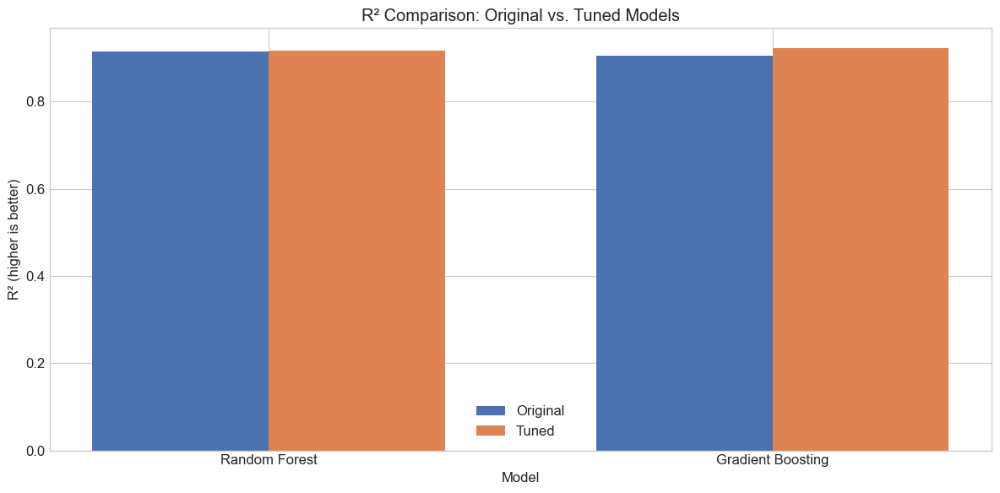

In [350]:
# Create bar chart comparing R² values
plt.figure(figsize=(12, 6))
original_r2 = [original_rf_r2, original_gb_r2]
tuned_r2 = [rf_r2, gb_r2]

plt.bar(x - width/2, original_r2, width, label='Original')
plt.bar(x + width/2, tuned_r2, width, label='Tuned')

plt.xlabel('Model')
plt.ylabel('R² (higher is better)')
plt.title('R² Comparison: Original vs. Tuned Models')
plt.xticks(x, models)
plt.legend()
plt.tight_layout()
plt.show()

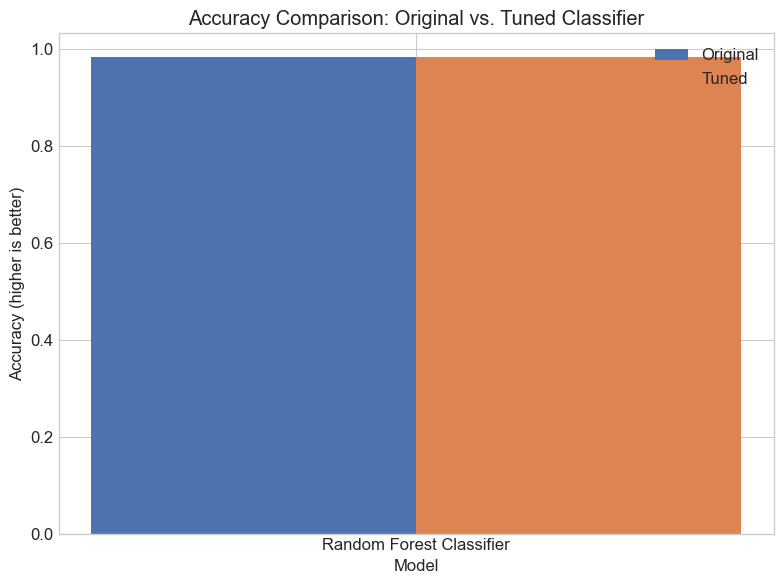

In [351]:
# Create bar chart comparing classifier accuracy
plt.figure(figsize=(8, 6))
models_clf = ['Random Forest Classifier']
original_acc = [original_rf_clf_accuracy]
tuned_acc = [rf_clf_accuracy]

x_clf = np.arange(len(models_clf))

plt.bar(x_clf - width/2, original_acc, width, label='Original')
plt.bar(x_clf + width/2, tuned_acc, width, label='Tuned')

plt.xlabel('Model')
plt.ylabel('Accuracy (higher is better)')
plt.title('Accuracy Comparison: Original vs. Tuned Classifier')
plt.xticks(x_clf, models_clf)
plt.legend()
plt.tight_layout()
plt.show()

## Part 6: Final model selection and summary

In [352]:
if rf_rmse < gb_rmse:
    best_regressor = "Random Forest"
    best_regressor_model = best_rf
    best_rmse = rf_rmse
    best_r2 = rf_r2
else:
    best_regressor = "Gradient Boosting"
    best_regressor_model = best_gb
    best_rmse = gb_rmse
    best_r2 = gb_r2

print(f"\nBest regression model: {best_regressor}")
print(f"Performance metrics - RMSE: {best_rmse:.4f}, R²: {best_r2:.4f}")


Best regression model: Gradient Boosting
Performance metrics - RMSE: 2.5428, R²: 0.9224


In [353]:
# Save a summary of the tuning process and results
with open('model_tuning_summary.txt', 'w') as f:
    f.write("Uber Trip Data Model Tuning Summary\n")
    f.write("==================================\n\n")

    f.write("1. Random Forest Regressor\n")
    f.write(f"   Best parameters: {rf_random.best_params_}\n")
    f.write(f"   Original RMSE: {original_rf_rmse:.4f}, R²: {original_rf_r2:.4f}\n")
    f.write(f"   Tuned RMSE: {rf_rmse:.4f}, R²: {rf_r2:.4f}\n")
    f.write(f"   Improvement - RMSE: {((original_rf_rmse - rf_rmse) / original_rf_rmse * 100):.2f}%, "
           f"R²: {((rf_r2 - original_rf_r2) / original_rf_r2 * 100):.2f}%\n\n")

    f.write("2. Gradient Boosting Regressor\n")
    f.write(f"   Best parameters: {gb_random.best_params_}\n")
    f.write(f"   Original RMSE: {original_gb_rmse:.4f}, R²: {original_gb_r2:.4f}\n")
    f.write(f"   Tuned RMSE: {gb_rmse:.4f}, R²: {gb_r2:.4f}\n")
    f.write(f"   Improvement - RMSE: {((original_gb_rmse - gb_rmse) / original_gb_rmse * 100):.2f}%, "
           f"R²: {((gb_r2 - original_gb_r2) / original_gb_r2 * 100):.2f}%\n\n")

    f.write("3. Random Forest Classifier\n")
    f.write(f"   Best parameters: {rf_clf_random.best_params_}\n")
    f.write(f"   Original accuracy: {original_rf_clf_accuracy:.4f}\n")
    f.write(f"   Tuned accuracy: {rf_clf_accuracy:.4f}\n")
    f.write(f"   Improvement: {((rf_clf_accuracy - original_rf_clf_accuracy) / original_rf_clf_accuracy * 100):.2f}%\n\n")

    f.write(f"Final recommendation: {best_regressor} for fare prediction with RMSE {best_rmse:.4f} and R² {best_r2:.4f}\n")

print("\nTuning process completed. Results saved to disk.")
print("Files generated:")
print("- best_random_forest_regressor.pkl")
print("- best_gradient_boosting_regressor.pkl")
print("- best_random_forest_classifier.pkl")
print("- tuned_rf_feature_importance.png")
print("- tuned_rf_clf_confusion_matrix.png")
print("- rmse_comparison.png")
print("- r2_comparison.png")
print("- accuracy_comparison.png")
print("- model_tuning_summary.txt")


Tuning process completed. Results saved to disk.
Files generated:
- best_random_forest_regressor.pkl
- best_gradient_boosting_regressor.pkl
- best_random_forest_classifier.pkl
- tuned_rf_feature_importance.png
- tuned_rf_clf_confusion_matrix.png
- rmse_comparison.png
- r2_comparison.png
- accuracy_comparison.png
- model_tuning_summary.txt


In [ ]:
# Optional: Clean up memory
import gc
gc.collect()